<a href="https://colab.research.google.com/github/EthanIrwin/AI/blob/master/CorgiPower.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!unzip "/content/drive/My Drive/RuTanks7000_v1.zip"

Archive:  /content/drive/My Drive/RuTanks7000_v1.zip
   creating: RuTanks7000_v1/test/
   creating: RuTanks7000_v1/test/Background/
  inflating: RuTanks7000_v1/test/Background/Background_01.JPG  
  inflating: RuTanks7000_v1/test/Background/Background_02.JPG  
  inflating: RuTanks7000_v1/test/Background/Background_03.JPG  
  inflating: RuTanks7000_v1/test/Background/Background_04.JPG  
  inflating: RuTanks7000_v1/test/Background/Background_05.JPG  
  inflating: RuTanks7000_v1/test/Background/Background_06.jpg  
  inflating: RuTanks7000_v1/test/Background/Background_07.jpg  
  inflating: RuTanks7000_v1/test/Background/Background_08.jpg  
  inflating: RuTanks7000_v1/test/Background/Background_09.jpg  
  inflating: RuTanks7000_v1/test/Background/Background_10.jpg  
  inflating: RuTanks7000_v1/test/Background/Background_11.JPG  
  inflating: RuTanks7000_v1/test/Background/Background_12.JPG  
  inflating: RuTanks7000_v1/test/Background/Background_13.JPG  
  inflating: RuTanks7000_v1/test/Bac

Found 42000 images belonging to 6 classes.
Found 90 images belonging to 6 classes.

### LEVEL1 ###
pretrained network:
Model: "NASNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 331, 331, 3)  0                                            
__________________________________________________________________________________________________
stem_conv1 (Conv2D)             (None, 165, 165, 96) 2592        input_2[0][0]                    
__________________________________________________________________________________________________
stem_bn1 (BatchNormalization)   (None, 165, 165, 96) 384         stem_conv1[0][0]                 
__________________________________________________________________________________________________
activation_261 (Activation)     (None, 165, 165, 96) 0           stem_bn1

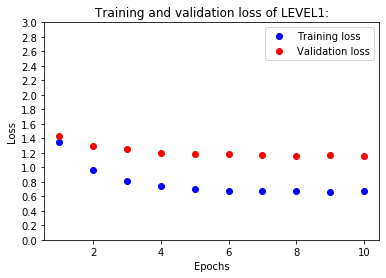

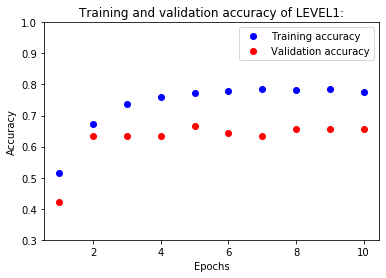


### LEVEL1 Training finished successfully ###

Loading trained weights from /content/trained_models/trained_weights/weights_temp.h5 ...

### Saving Level1 Model to  /content/trained_models/RuTanks7000_v1_l1.h5  ... 


### LEVEL2 ###

Loading trained weights from /content/trained_models/trained_weights/weights_temp.h5 ...

trainable layers before unfreezing the base network up to normal_add_1_15:  510
trainable layers after the base network unfreezed from layer normal_add_1_15:  71

LEVEL2 Model after unfreezing the base network
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 11, 11, 4032)      84916818  
_________________________________________________________________
global_average_pooling2d_1 ( (None, 4032)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)        

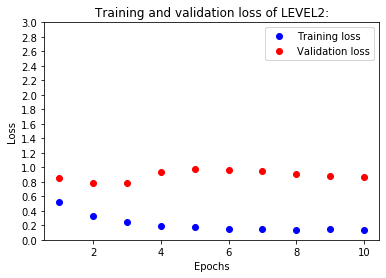

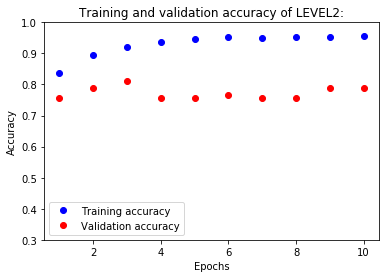


###LEVEL2 Training finished successfully ###
Time elapsed in minutes:  83.95188659854999


In [0]:
# Ugur Uysal

# ugur.uysal.86@gmail.com

# 02. Aug 2019



# imports

import os

from keras.applications import NASNetLarge

from keras import models, layers, optimizers, backend

from keras.models import load_model

from keras.preprocessing.image import ImageDataGenerator

from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, TensorBoard

import matplotlib.pyplot as plt

import numpy as np

from timeit import default_timer as timer





def main():

    start = timer()

    level1()  # Training the classifier only

    level2()  # Training the pretrained model + the trained classifier from level 1

    end = timer()

    print("Time elapsed in minutes: ", ((end - start)/60))



# Setting Parameters ##################################################################

# image settings

img_height,img_width = 331, 331  # For NASNetLarge



# classes

classnames = ["Background", "BMP2", "Buk-M1-2", "T14", "T90", "ZSU23"]

classes = len(classnames)



# path settings

path = '/content/'

dataset_path = path+'RuTanks7000_v1/'

weights_path = path+'trained_models/trained_weights/weights_temp.h5'

model_path = path+'trained_models/RuTanks7000_v1_'

TensorBoardLogDir = path+'logs'



nbrTrainImages = 7000  # per class

nbrTestImages = 0  # Value gets accurate after counting (Total Number of test images)

for ImagesClass in os.listdir(dataset_path+'test/'):

    nbrTestImages += len(os.listdir(dataset_path+'test/'+ImagesClass))



# unfreezing the base network up to a specific layer in Level2:

freezeUptoLayer = "normal_add_1_15"   # NASNetLarge



# hyperparameters

learning_rate = 0.0002  # Learning_rate in Level 2 = learning_rate/10

lr_decay = 0.0001

batch = 64

fcLayer1 = 32

dropout = 0.5



epochsL1 = 10

patiencel1 = 1

factorL1 = 0.5



epochsL2 = 10

patiencel2 = 1

factorL2 = 0.5



verbose_train = 1



# datagenerators https://keras.io/preprocessing/image/

train_datagen = ImageDataGenerator(

    rescale=1./255,

    rotation_range=30,

    width_shift_range=0.2,

    height_shift_range=0.2,

    shear_range=0.2,

    zoom_range=0.2,

    fill_mode='nearest',

    horizontal_flip=True)

train_generator = train_datagen.flow_from_directory(

    dataset_path+'train',

    target_size=(img_height, img_width),

    batch_size=batch,

    shuffle=True,

    classes=classnames,

    class_mode='categorical')



test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(

    dataset_path+'test',

    target_size=(img_height, img_width),

    batch_size=1,

    shuffle=True,

    classes=classnames,

    class_mode='categorical')

#########################################################################################



# function to plot results of model performance

def plot(h,t,e):

    history_dict = h[0]

    loss_values = history_dict['loss']

    validation_loss_values = history_dict['val_loss']

    acc_values = history_dict['acc']

    validation_acc_values = history_dict['val_acc']

    epochs_range = range(1, e + 1)



    # Plotting Training and Validation loss of the corresponding Model

    plt.plot(epochs_range, loss_values, 'bo', label='Training loss')

    plt.plot(epochs_range, validation_loss_values, 'ro', label='Validation loss')

    plt.title('Training and validation loss of ' + t)

    plt.xlabel('Epochs')

    plt.ylabel('Loss')

    plt.yticks(np.arange(0, 3.1, step=0.2))

    plt.legend()

    plt.show()



    # Plotting Training and Validation accuracy of the corresponding Model

    plt.plot(epochs_range, acc_values, 'bo', label='Training accuracy')

    plt.plot(epochs_range, validation_acc_values, 'ro', label='Validation accuracy')

    plt.title('Training and validation accuracy of ' + t)

    plt.xlabel('Epochs')

    plt.ylabel('Accuracy')

    plt.yticks(np.arange(0.3, 1.1, step=0.1))

    plt.legend()

    plt.show()





# LEVEL1 - Training of densely connected layers

def level1():

    # Building the model using the pretrained model

    conv_base1 = NASNetLarge(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))

    print("\n### LEVEL1 ###\npretrained network:")

    conv_base1.summary()

    model = models.Sequential()

    model.add(conv_base1)

    model.add(layers.GlobalAveragePooling2D())

    model.add(layers.Dense(fcLayer1, activation='relu'))

    model.add(layers.Dropout(dropout))

    model.add(layers.Dense(classes, activation='softmax'))



    # freezing the base network

    print("trainable layers bevor freezing:", int(len(model.trainable_weights)/2)) # weights = weights + bias = 2 pro layer

    conv_base1.trainable = False

    print("trainable layers after freezing:", int(len(model.trainable_weights)/2))

    print("\npretrained network + densely connected classifier")

    model.summary()



    # training the added layers only

    model.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate, decay=lr_decay), metrics=['acc'])



    callbacks_list_L1 = [ModelCheckpoint(filepath=weights_path, save_weights_only=True, monitor='val_acc', verbose=1, save_best_only=True),

                      ReduceLROnPlateau(monitor='val_acc', factor=factorL1, patience=patiencel1, verbose=1),

                      TensorBoard(log_dir=TensorBoardLogDir+'\\level1')]



    print("\n### Level1 Training ... ")

    # training the model

    history = model.fit_generator(

        train_generator,

        steps_per_epoch=(nbrTrainImages * classes) // (5 * batch),

        epochs=epochsL1,

        callbacks=callbacks_list_L1,

        validation_data=test_generator,

        validation_steps=nbrTestImages,

        verbose=verbose_train)



    history_val1 = [history.history]  # saving all results of the final test

    plot(history_val1, "LEVEL1:", epochsL1)

    print("\n### LEVEL1 Training finished successfully ###")



    print("\nLoading trained weights from " + weights_path + " ...")

    model.load_weights(weights_path)

    model.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate), metrics=['acc'])

    print("\n### Saving Level1 Model to ", model_path+'l1.h5', " ... ")

    model.save(model_path+'l1.h5')





# LEVEL2 - Training pretrained network and trained densely connected layers

def level2():

    # Destroying the current TF graph - https://keras.io/backend/

    backend.clear_session()

    print("\n### LEVEL2 ###")

    conv_base2 = NASNetLarge(weights='imagenet', include_top=False, input_shape=(img_height, img_width, 3))

    model2 = models.Sequential()

    model2.add(conv_base2)

    model2.add(layers.GlobalAveragePooling2D())

    model2.add(layers.Dense(fcLayer1, activation='relu'))

    model2.add(layers.Dropout(dropout))

    model2.add(layers.Dense(classes, activation='softmax'))



    print("\nLoading trained weights from " + weights_path + " ...")

    model2.load_weights(weights_path)



    # unfreezing the base network up to a specific layer:

    if freezeUptoLayer == "":

        conv_base2.trainable = True

        print ("\ntrainable layers: ",int(len(model2.trainable_weights) / 2))

    else:

        print("\ntrainable layers before unfreezing the base network up to " + freezeUptoLayer + ": ",int(len(model2.trainable_weights) / 2))  # weights = weights + bias = 2 pro layer

        conv_base2.trainable = True

        set_trainable = False

        for layer in conv_base2.layers:

            if layer.name == freezeUptoLayer: set_trainable = True

            if set_trainable: layer.trainable = True

            else: layer.trainable = False

        print("trainable layers after the base network unfreezed from layer " + freezeUptoLayer + ": ", int(len(model2.trainable_weights)/2))



    print("\nLEVEL2 Model after unfreezing the base network")

    model2.summary()

    model2.compile(loss='categorical_crossentropy', optimizer=optimizers.RMSprop(lr=learning_rate/10, decay=lr_decay), metrics=['acc'])

    print ("\n### Validating ... ")



    val_loss, val_acc = model2.evaluate_generator(test_generator, steps=nbrTestImages, verbose=0)

    print('Validation Results before training unfreeze layers and trained densely connected layers:\nValidation loss:',val_loss,",",'Validation accuracy:', val_acc, "\n")



    # Jointly training both the unfreeze layers and the added trained densely connected layers

    callbacks_list_L2 = [ModelCheckpoint(filepath=model_path+'l2.h5', save_weights_only=False, monitor='val_acc', verbose=1, save_best_only=True),

                      ReduceLROnPlateau(monitor='val_acc', factor=factorL2, patience=patiencel2, verbose=1),

                      TensorBoard(log_dir=TensorBoardLogDir+'\\level2')]



    print ("\n### Level2 Training ... ")

    history = model2.fit_generator(

        train_generator,

        steps_per_epoch=(nbrTrainImages * classes) // (5 * batch),

        epochs=epochsL2,

        callbacks=callbacks_list_L2,

        validation_data=test_generator,

        validation_steps=nbrTestImages,

        verbose=verbose_train)



    history_val2 = [history.history]  # saving all results of the final test

    plot(history_val2, "LEVEL2:", epochsL2)

    print("\n###LEVEL2 Training finished successfully ###")





main()



# References

# Chollet, F. (2018). Deep learning with Python. Section 5.3 - Using a pretrained convnet.



Found 90 images belonging to 6 classes.
Loading the trained model from /content/trained_models/RuTanks7000_v1_l2.h5 ...


Trained model /content/trained_models/RuTanks7000_v1_l2.h5:
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
NASNet (Model)               (None, 11, 11, 4032)      84916818  
_________________________________________________________________
global_average_pooling2d_1 ( (None, 4032)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 32)                129056    
_________________________________________________________________
dropout_1 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 6)                 198       
Total params: 85,046,072
Trainable params: 30,292,646
Non-trainable pa

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:241: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=[<tf.Tenso..., inputs=Tensor("NA...)`


img_tensors_array.shape= (90, 331, 331, 3)
activations.shape= (90, 32)


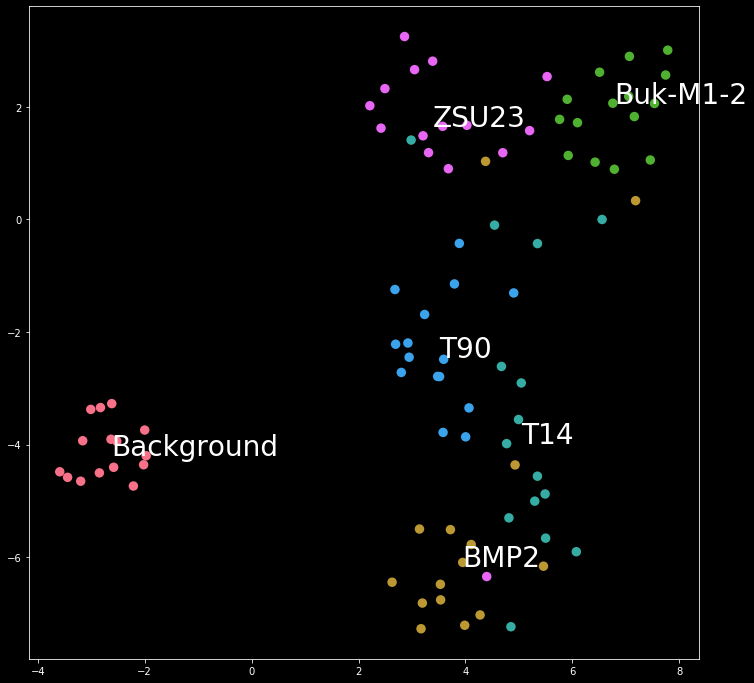


Class Predictions of test images from /content/RuTanks7000_v1/test/
Image 1 : [(99.65, 'Background'), (0.23, 'Buk-M1-2'), (0.1, 'T90'), (0.01, 'BMP2'), (0.0, 'ZSU23'), (0.0, 'T14')]


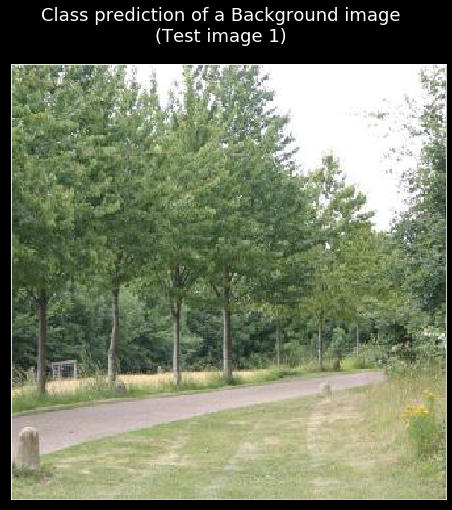

Image 2 : [(99.21, 'Background'), (0.55, 'Buk-M1-2'), (0.11, 'T90'), (0.09, 'BMP2'), (0.03, 'T14'), (0.01, 'ZSU23')]


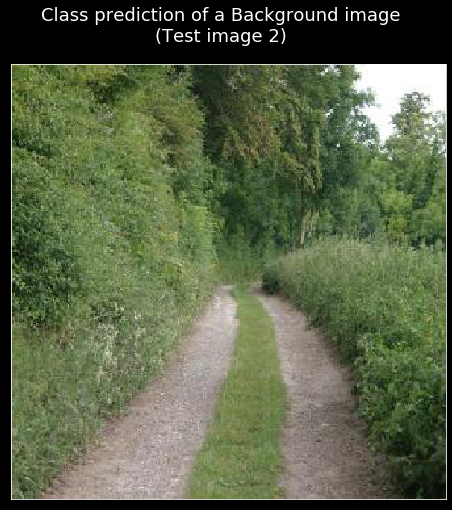

Image 3 : [(99.16, 'Background'), (0.59, 'Buk-M1-2'), (0.13, 'T90'), (0.1, 'BMP2'), (0.01, 'T14'), (0.0, 'ZSU23')]


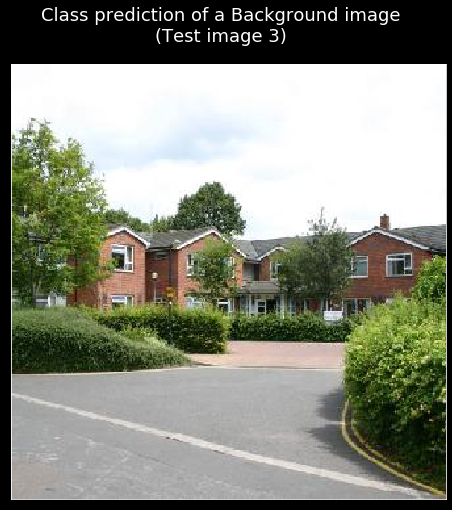

Image 4 : [(98.98, 'Background'), (0.72, 'T90'), (0.25, 'Buk-M1-2'), (0.02, 'ZSU23'), (0.02, 'T14'), (0.01, 'BMP2')]


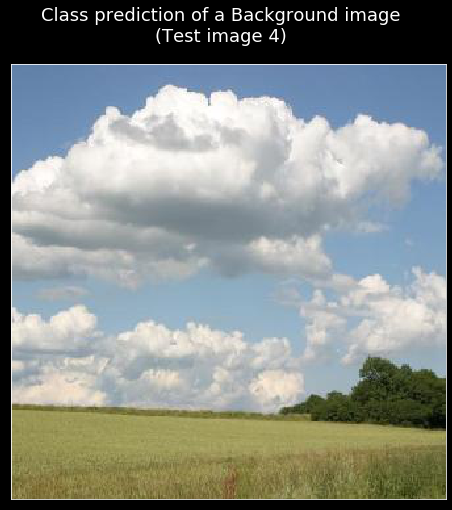

Image 5 : [(95.55, 'Background'), (2.64, 'Buk-M1-2'), (0.96, 'BMP2'), (0.76, 'T90'), (0.05, 'T14'), (0.04, 'ZSU23')]


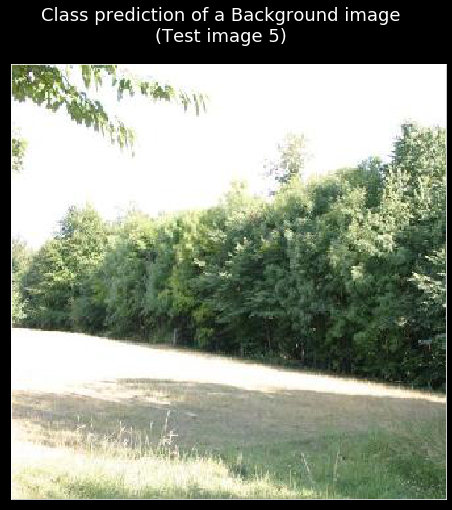

Image 6 : [(99.76, 'Background'), (0.16, 'Buk-M1-2'), (0.04, 'T90'), (0.04, 'BMP2'), (0.0, 'ZSU23'), (0.0, 'T14')]


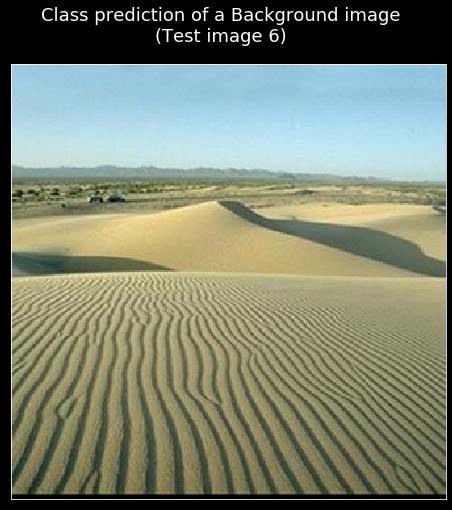

Image 7 : [(99.77, 'Background'), (0.16, 'Buk-M1-2'), (0.04, 'BMP2'), (0.03, 'T90'), (0.0, 'ZSU23'), (0.0, 'T14')]


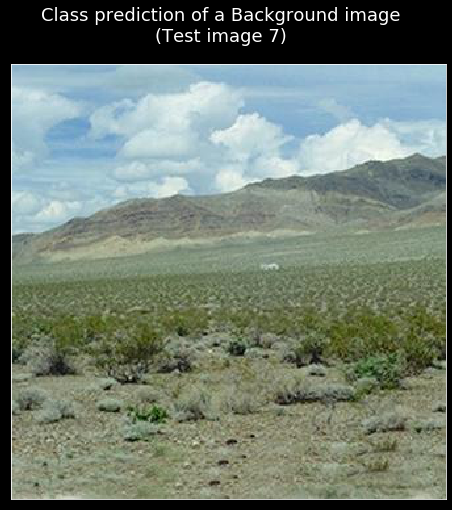

Image 8 : [(97.82, 'Background'), (1.33, 'T90'), (0.43, 'Buk-M1-2'), (0.24, 'T14'), (0.16, 'BMP2'), (0.02, 'ZSU23')]


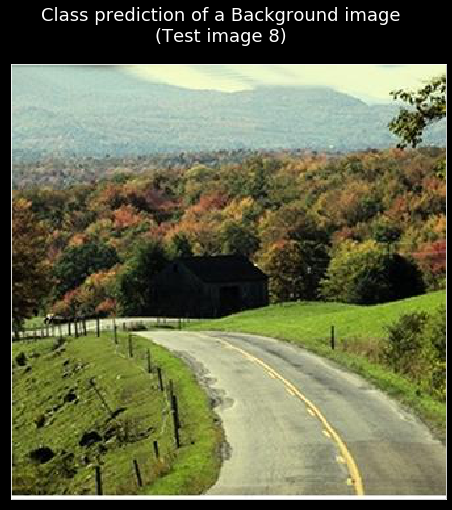

Image 9 : [(99.32, 'Background'), (0.49, 'Buk-M1-2'), (0.13, 'T90'), (0.03, 'T14'), (0.03, 'BMP2'), (0.01, 'ZSU23')]


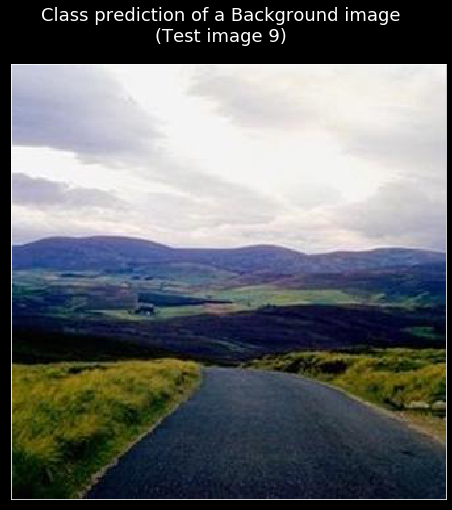

Image 10 : [(98.62, 'Background'), (0.59, 'T90'), (0.34, 'BMP2'), (0.28, 'Buk-M1-2'), (0.17, 'T14'), (0.01, 'ZSU23')]


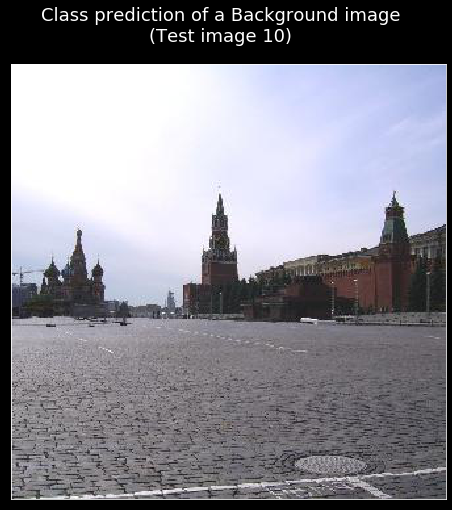

Image 11 : [(99.2, 'Background'), (0.35, 'Buk-M1-2'), (0.34, 'T90'), (0.08, 'BMP2'), (0.03, 'T14'), (0.01, 'ZSU23')]


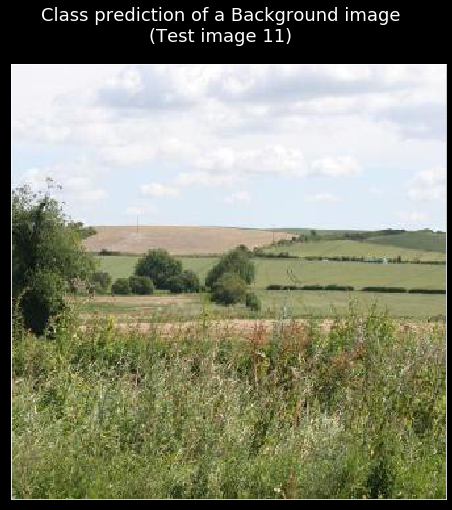

Image 12 : [(98.23, 'Background'), (0.92, 'T90'), (0.74, 'Buk-M1-2'), (0.05, 'T14'), (0.04, 'ZSU23'), (0.02, 'BMP2')]


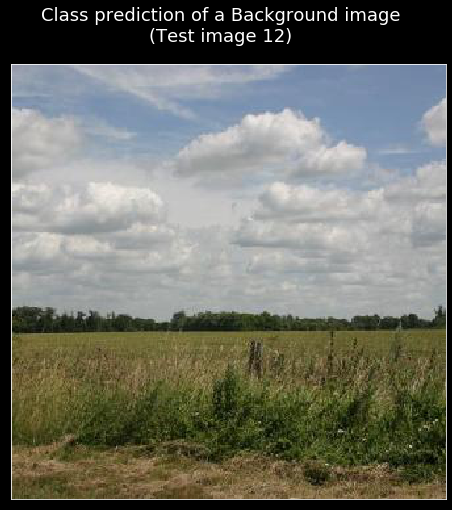

Image 13 : [(99.05, 'Background'), (0.66, 'T90'), (0.24, 'Buk-M1-2'), (0.03, 'ZSU23'), (0.01, 'T14'), (0.01, 'BMP2')]


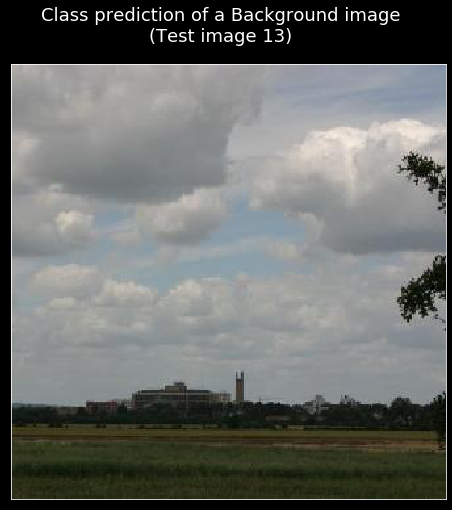

Image 14 : [(99.19, 'Background'), (0.73, 'Buk-M1-2'), (0.05, 'BMP2'), (0.04, 'T90'), (0.0, 'ZSU23'), (0.0, 'T14')]


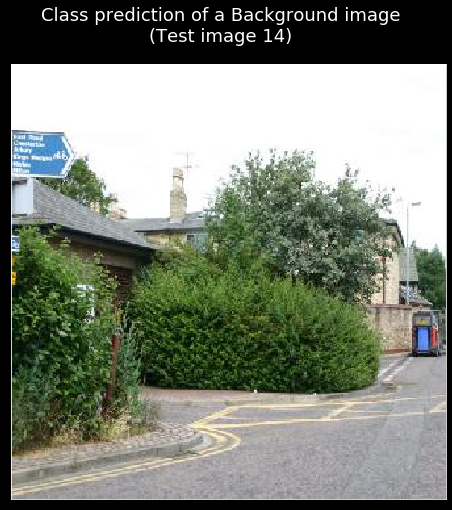

Image 15 : [(95.4, 'Background'), (2.04, 'Buk-M1-2'), (1.44, 'T90'), (0.93, 'BMP2'), (0.17, 'T14'), (0.02, 'ZSU23')]


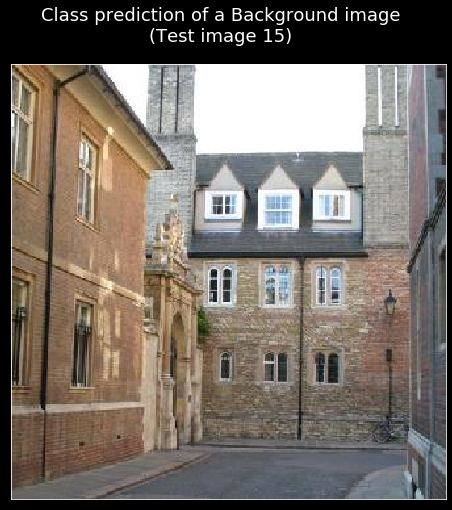

Image 16 : [(82.27, 'BMP2'), (10.02, 'T90'), (3.47, 'Background'), (2.94, 'T14'), (1.04, 'Buk-M1-2'), (0.25, 'ZSU23')]


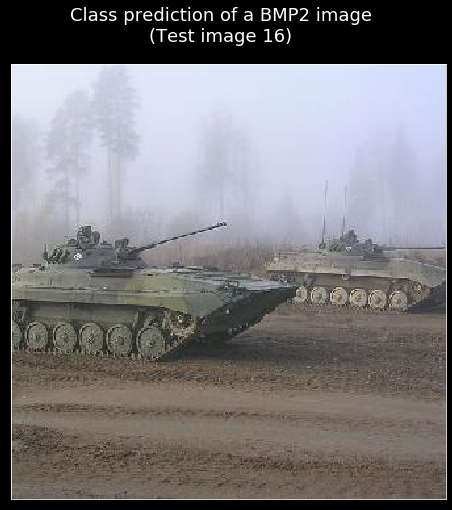

Image 17 : [(95.79, 'BMP2'), (2.24, 'T90'), (1.35, 'Background'), (0.53, 'Buk-M1-2'), (0.08, 'T14'), (0.01, 'ZSU23')]


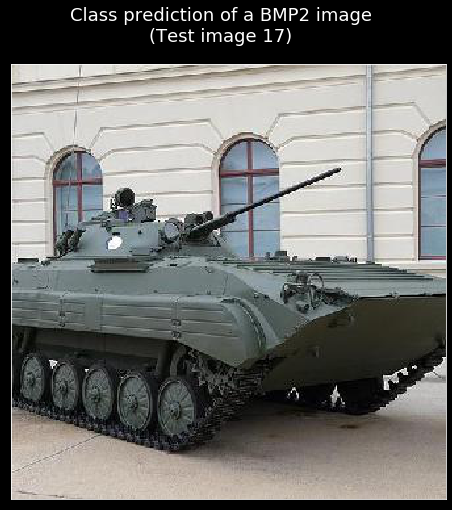

Image 18 : [(54.93, 'Buk-M1-2'), (17.32, 'T90'), (13.15, 'ZSU23'), (12.33, 'Background'), (1.97, 'BMP2'), (0.29, 'T14')]


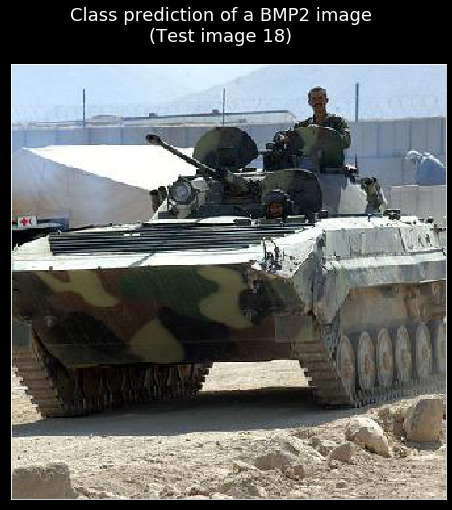

Image 19 : [(48.31, 'BMP2'), (24.76, 'T90'), (17.96, 'Background'), (4.33, 'T14'), (3.83, 'Buk-M1-2'), (0.8, 'ZSU23')]


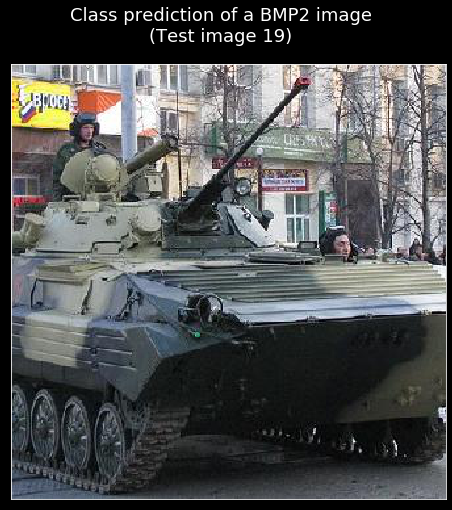

Image 20 : [(78.85, 'BMP2'), (16.8, 'T90'), (3.11, 'Background'), (0.93, 'Buk-M1-2'), (0.24, 'T14'), (0.06, 'ZSU23')]


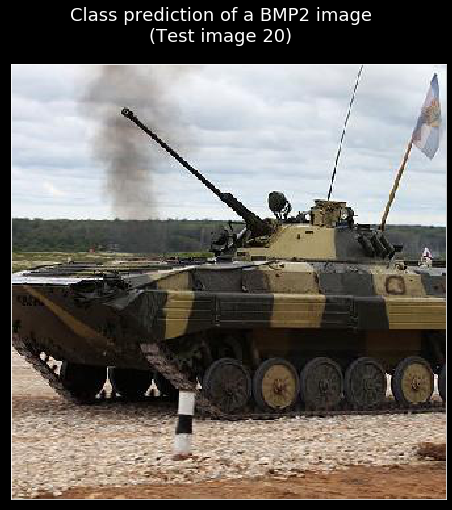

Image 21 : [(67.95, 'Buk-M1-2'), (19.19, 'Background'), (11.8, 'BMP2'), (0.85, 'T90'), (0.13, 'T14'), (0.08, 'ZSU23')]


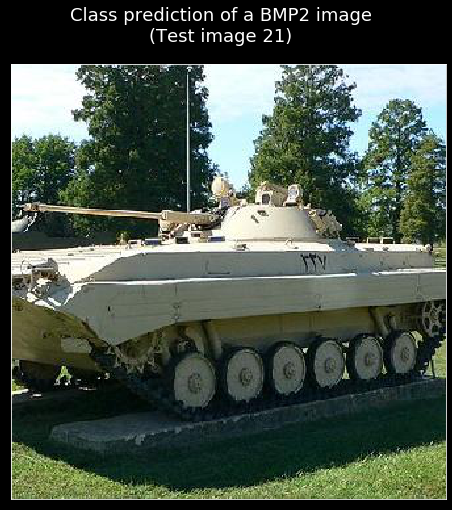

Image 22 : [(90.33, 'BMP2'), (4.11, 'T90'), (3.44, 'Background'), (1.76, 'Buk-M1-2'), (0.2, 'T14'), (0.15, 'ZSU23')]


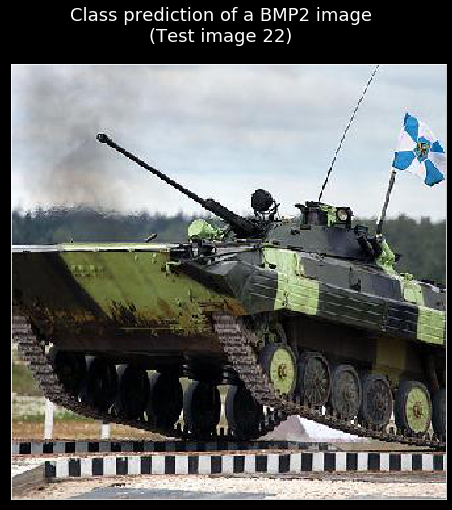

Image 23 : [(93.91, 'BMP2'), (3.5, 'T90'), (1.32, 'Background'), (1.2, 'Buk-M1-2'), (0.04, 'T14'), (0.03, 'ZSU23')]


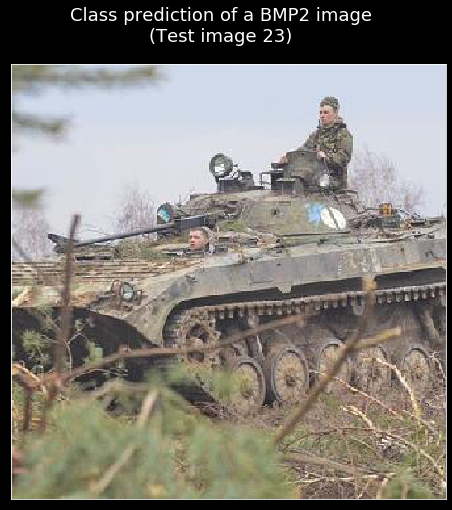

Image 24 : [(79.73, 'BMP2'), (8.37, 'T14'), (8.03, 'T90'), (2.29, 'Background'), (1.34, 'Buk-M1-2'), (0.25, 'ZSU23')]


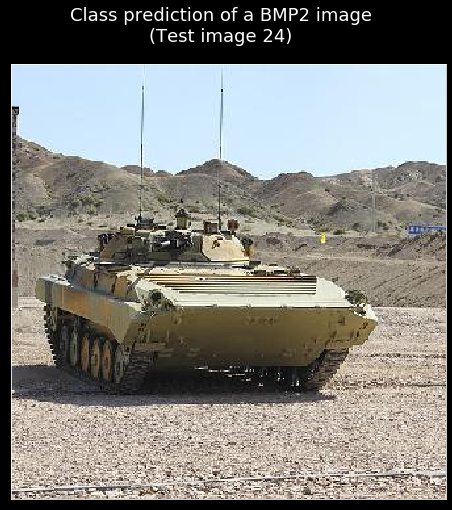

Image 25 : [(97.62, 'BMP2'), (1.56, 'T90'), (0.28, 'Buk-M1-2'), (0.27, 'Background'), (0.25, 'T14'), (0.01, 'ZSU23')]


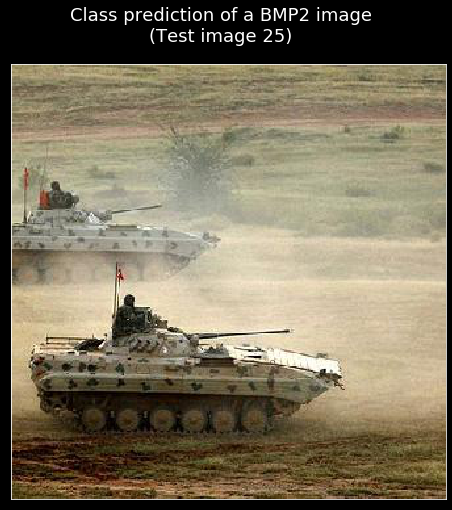

Image 26 : [(60.03, 'BMP2'), (27.74, 'T90'), (6.39, 'Background'), (3.0, 'Buk-M1-2'), (2.32, 'ZSU23'), (0.52, 'T14')]


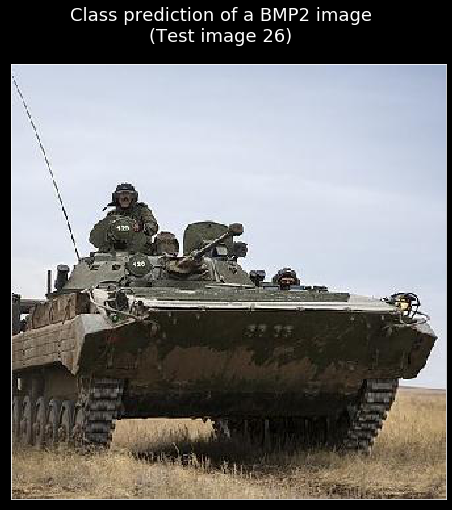

Image 27 : [(49.91, 'T14'), (18.59, 'T90'), (12.84, 'BMP2'), (10.11, 'Buk-M1-2'), (8.33, 'Background'), (0.23, 'ZSU23')]


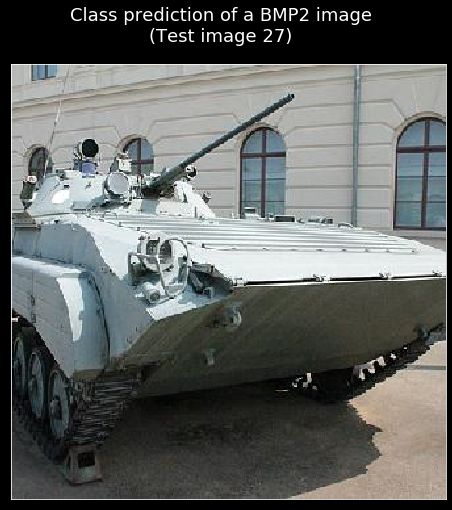

Image 28 : [(85.14, 'BMP2'), (11.25, 'T90'), (2.14, 'Background'), (0.77, 'T14'), (0.52, 'Buk-M1-2'), (0.18, 'ZSU23')]


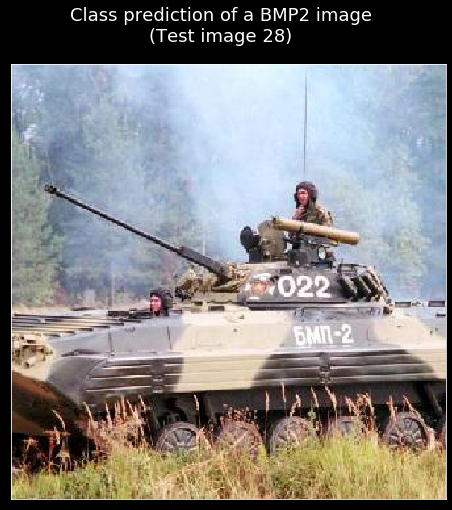

Image 29 : [(61.29, 'Background'), (25.99, 'BMP2'), (8.55, 'T90'), (2.03, 'T14'), (1.59, 'Buk-M1-2'), (0.55, 'ZSU23')]


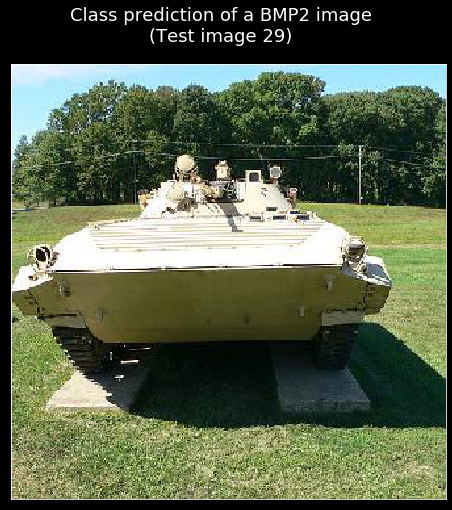

Image 30 : [(82.62, 'BMP2'), (12.4, 'T14'), (1.77, 'Buk-M1-2'), (1.62, 'T90'), (1.58, 'Background'), (0.01, 'ZSU23')]


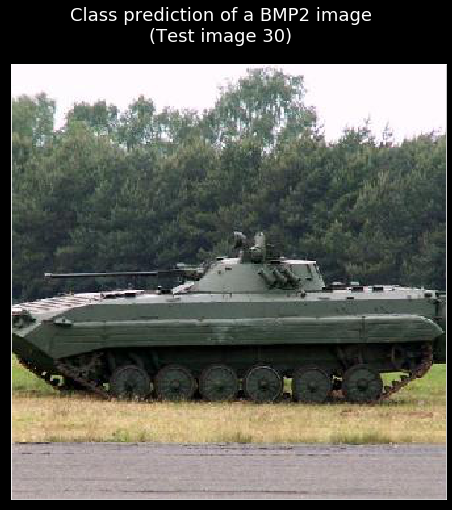

Image 31 : [(99.96, 'Buk-M1-2'), (0.04, 'Background'), (0.0, 'ZSU23'), (0.0, 'T90'), (0.0, 'T14'), (0.0, 'BMP2')]


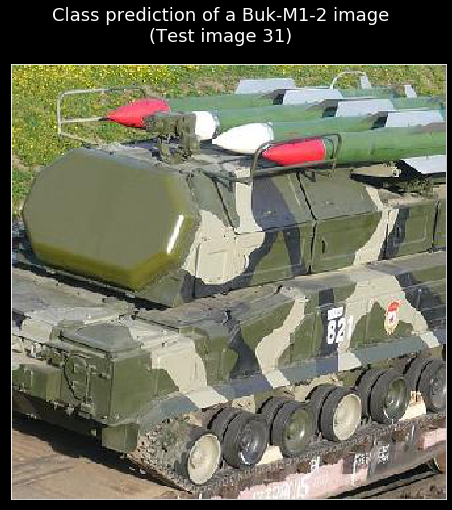

Image 32 : [(99.39, 'Buk-M1-2'), (0.31, 'Background'), (0.14, 'T90'), (0.12, 'BMP2'), (0.03, 'ZSU23'), (0.02, 'T14')]


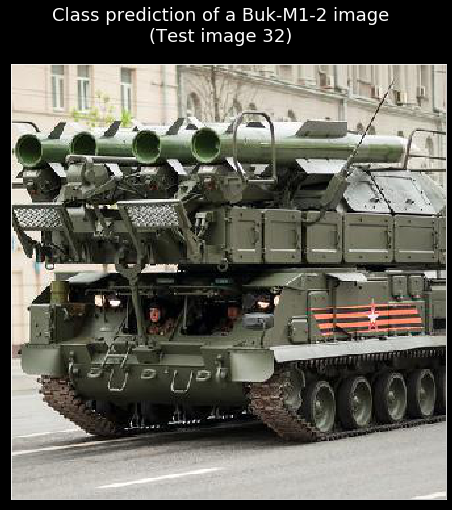

Image 33 : [(99.08, 'Buk-M1-2'), (0.64, 'Background'), (0.19, 'T90'), (0.07, 'BMP2'), (0.02, 'ZSU23'), (0.01, 'T14')]


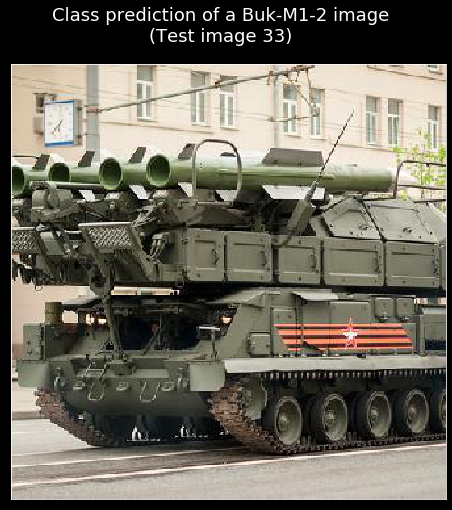

Image 34 : [(98.87, 'Buk-M1-2'), (0.74, 'Background'), (0.27, 'ZSU23'), (0.09, 'T90'), (0.02, 'T14'), (0.01, 'BMP2')]


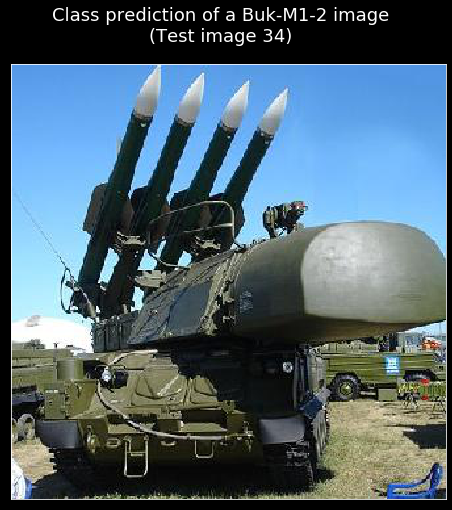

Image 35 : [(81.36, 'Buk-M1-2'), (17.63, 'Background'), (0.39, 'T90'), (0.35, 'BMP2'), (0.17, 'T14'), (0.11, 'ZSU23')]


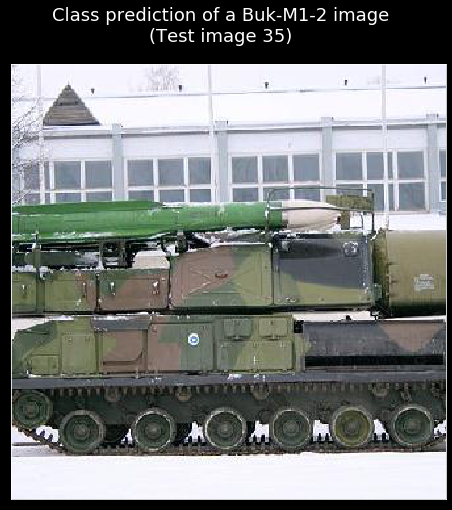

Image 36 : [(93.29, 'Buk-M1-2'), (3.6, 'Background'), (1.97, 'T90'), (0.88, 'ZSU23'), (0.15, 'T14'), (0.11, 'BMP2')]


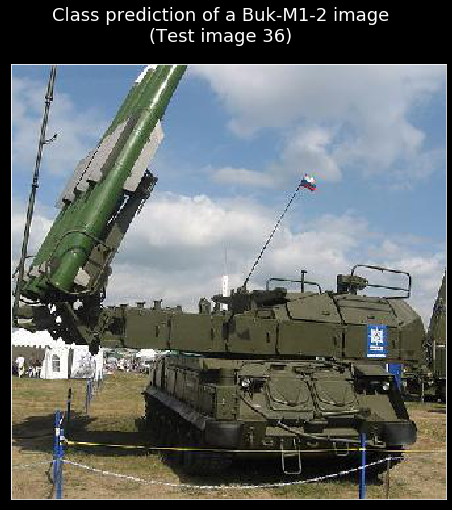

Image 37 : [(88.0, 'Buk-M1-2'), (5.87, 'Background'), (4.0, 'T90'), (1.02, 'BMP2'), (0.94, 'ZSU23'), (0.17, 'T14')]


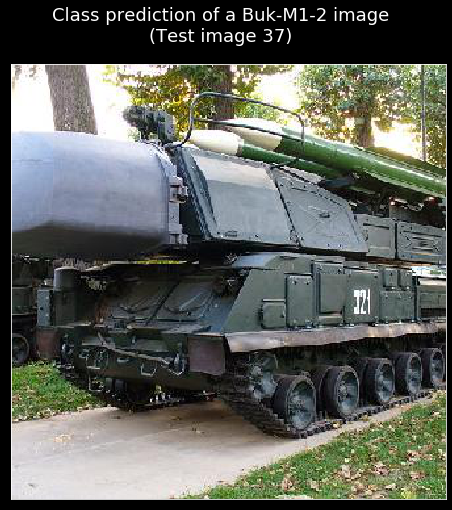

Image 38 : [(98.39, 'Buk-M1-2'), (1.34, 'Background'), (0.19, 'ZSU23'), (0.05, 'T90'), (0.04, 'BMP2'), (0.0, 'T14')]


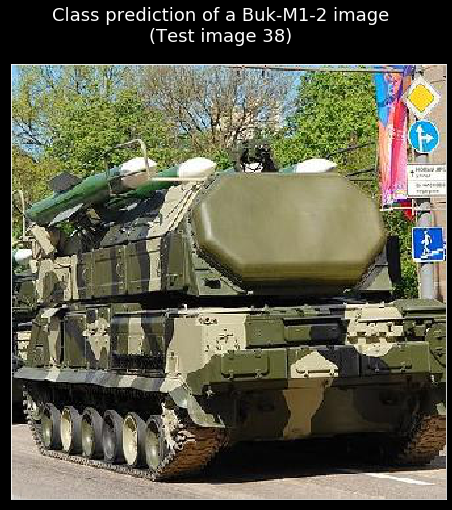

Image 39 : [(94.68, 'Buk-M1-2'), (2.37, 'T90'), (2.11, 'Background'), (0.54, 'ZSU23'), (0.27, 'BMP2'), (0.04, 'T14')]


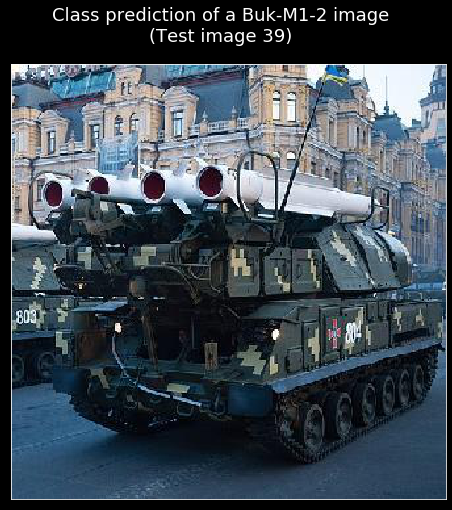

Image 40 : [(97.95, 'Buk-M1-2'), (1.7, 'Background'), (0.29, 'T90'), (0.04, 'ZSU23'), (0.02, 'T14'), (0.01, 'BMP2')]


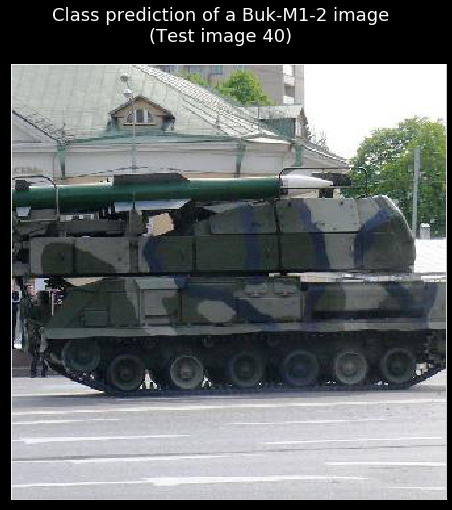

Image 41 : [(95.85, 'Buk-M1-2'), (1.73, 'ZSU23'), (1.63, 'Background'), (0.55, 'T90'), (0.22, 'BMP2'), (0.02, 'T14')]


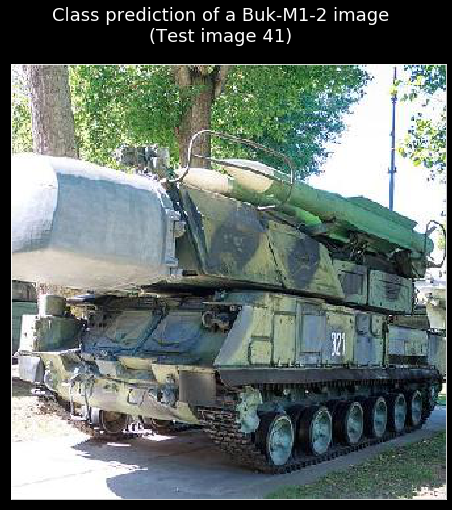

Image 42 : [(99.81, 'Buk-M1-2'), (0.15, 'Background'), (0.02, 'BMP2'), (0.01, 'T90'), (0.0, 'ZSU23'), (0.0, 'T14')]


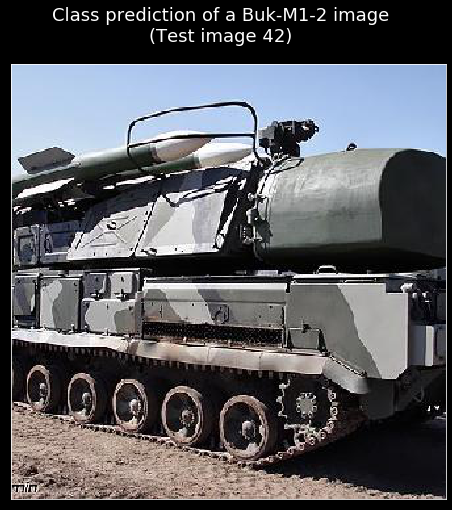

Image 43 : [(91.38, 'Buk-M1-2'), (3.54, 'Background'), (3.4, 'BMP2'), (1.49, 'T90'), (0.12, 'ZSU23'), (0.06, 'T14')]


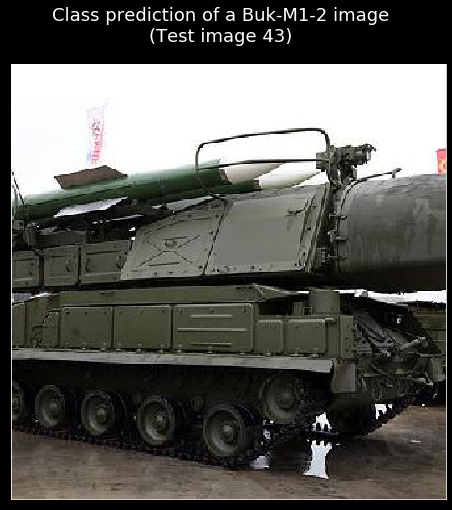

Image 44 : [(82.35, 'Buk-M1-2'), (10.54, 'Background'), (4.02, 'T90'), (2.5, 'BMP2'), (0.46, 'ZSU23'), (0.12, 'T14')]


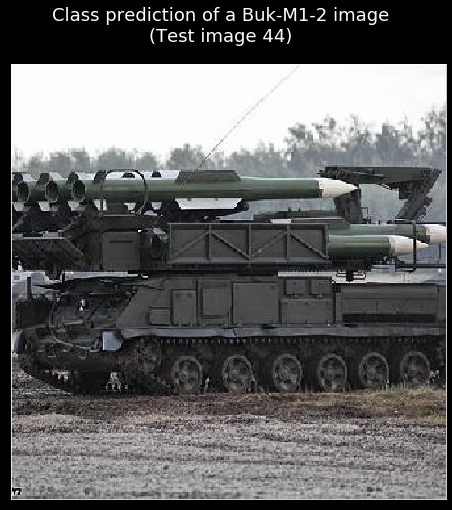

Image 45 : [(98.32, 'Buk-M1-2'), (1.42, 'Background'), (0.1, 'T90'), (0.08, 'BMP2'), (0.05, 'ZSU23'), (0.03, 'T14')]


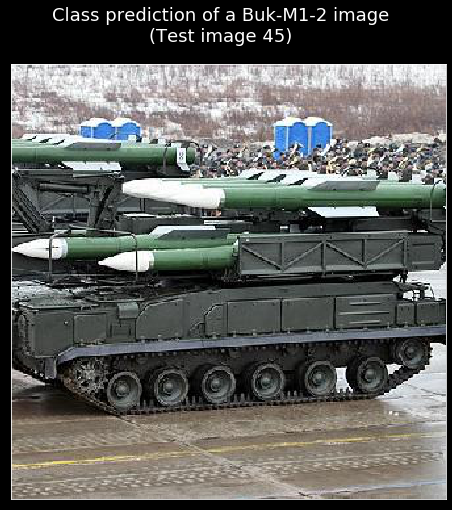

Image 46 : [(98.12, 'BMP2'), (1.07, 'T90'), (0.33, 'Background'), (0.29, 'Buk-M1-2'), (0.2, 'T14'), (0.0, 'ZSU23')]


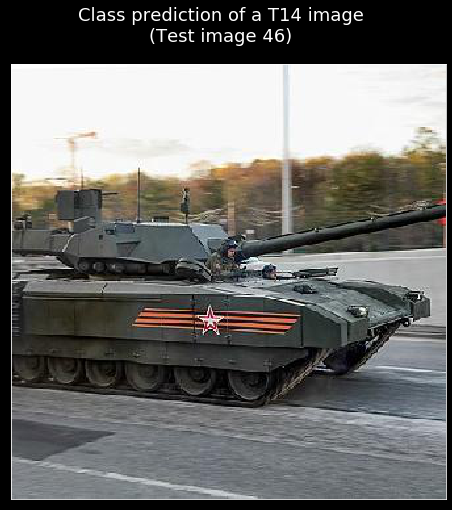

Image 47 : [(47.62, 'BMP2'), (14.88, 'T14'), (13.62, 'Buk-M1-2'), (13.45, 'Background'), (10.16, 'T90'), (0.27, 'ZSU23')]


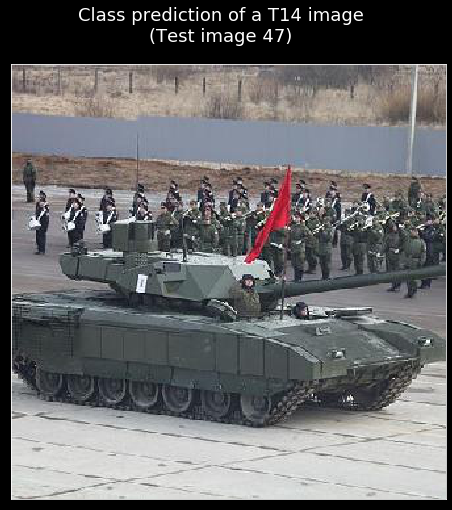

Image 48 : [(65.05, 'Buk-M1-2'), (22.43, 'BMP2'), (6.56, 'T90'), (5.08, 'Background'), (0.76, 'T14'), (0.12, 'ZSU23')]


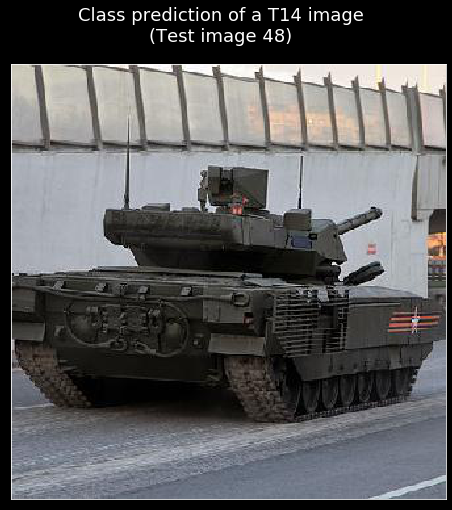

Image 49 : [(62.9, 'T14'), (17.27, 'BMP2'), (10.26, 'T90'), (4.8, 'Buk-M1-2'), (4.6, 'Background'), (0.17, 'ZSU23')]


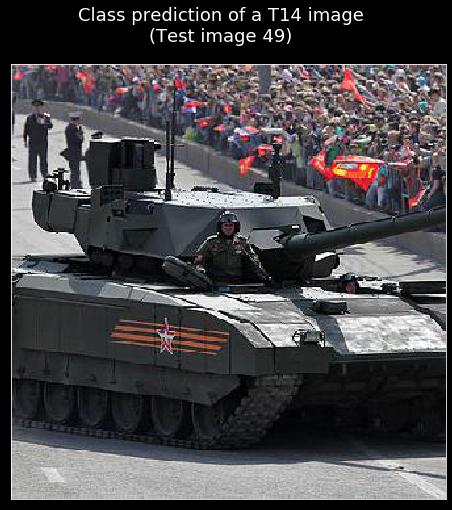

Image 50 : [(47.57, 'Buk-M1-2'), (36.39, 'Background'), (7.29, 'T14'), (5.9, 'ZSU23'), (1.43, 'BMP2'), (1.41, 'T90')]


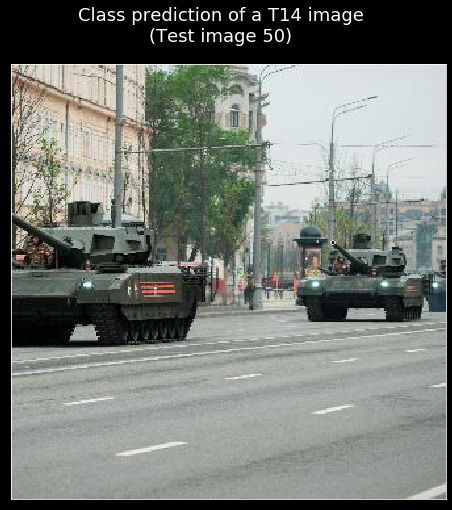

Image 51 : [(47.94, 'BMP2'), (40.6, 'T14'), (4.83, 'T90'), (4.08, 'Background'), (2.52, 'Buk-M1-2'), (0.04, 'ZSU23')]


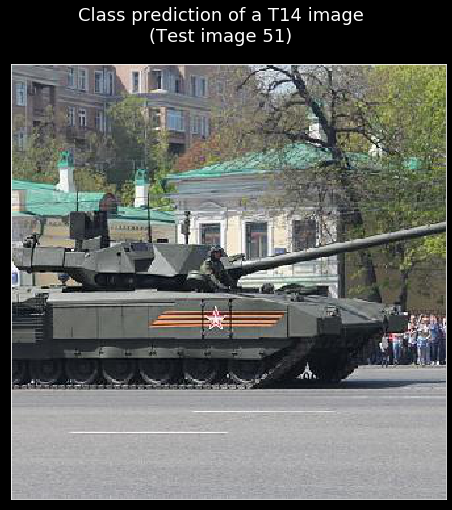

Image 52 : [(59.08, 'T14'), (24.25, 'T90'), (6.4, 'Buk-M1-2'), (5.2, 'BMP2'), (4.77, 'Background'), (0.29, 'ZSU23')]


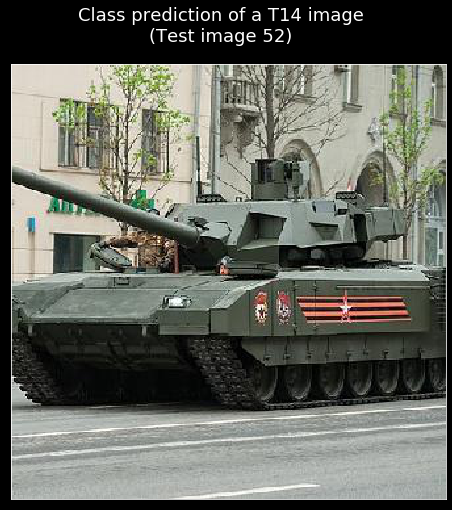

Image 53 : [(34.67, 'T14'), (28.83, 'Buk-M1-2'), (22.24, 'BMP2'), (10.26, 'T90'), (3.93, 'Background'), (0.07, 'ZSU23')]


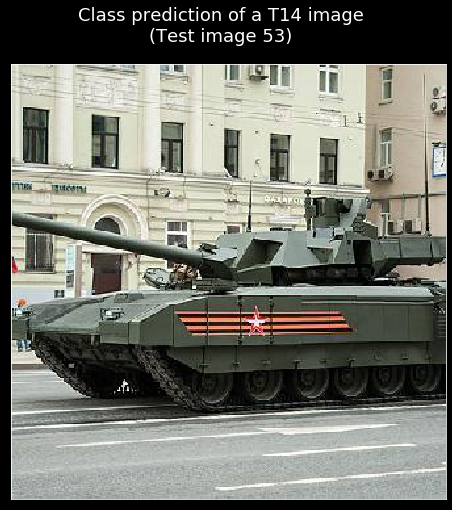

Image 54 : [(67.9, 'T14'), (29.8, 'BMP2'), (1.09, 'T90'), (0.88, 'Buk-M1-2'), (0.32, 'Background'), (0.01, 'ZSU23')]


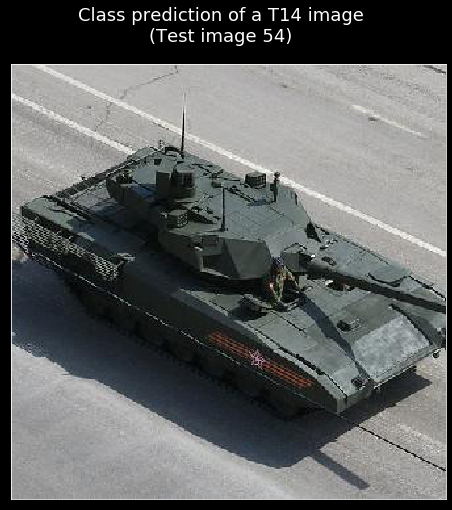

Image 55 : [(82.32, 'ZSU23'), (8.44, 'T90'), (5.21, 'Background'), (3.79, 'Buk-M1-2'), (0.17, 'BMP2'), (0.07, 'T14')]


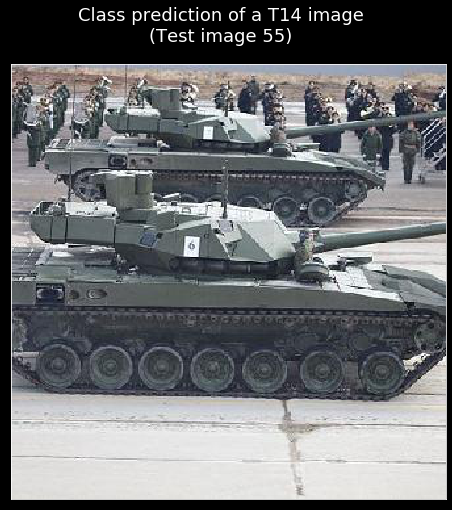

Image 56 : [(40.95, 'ZSU23'), (37.17, 'Buk-M1-2'), (7.42, 'T14'), (6.44, 'T90'), (5.55, 'Background'), (2.48, 'BMP2')]


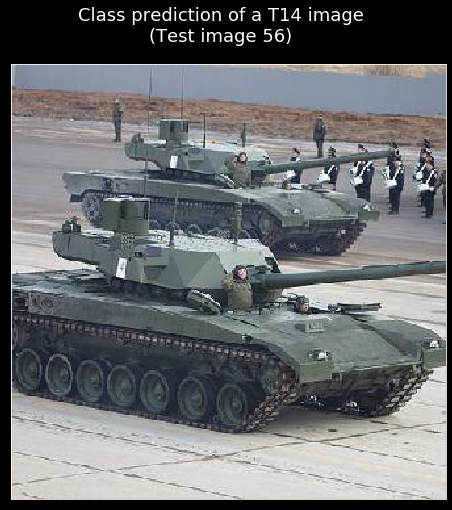

Image 57 : [(40.2, 'Buk-M1-2'), (32.95, 'T14'), (20.7, 'T90'), (4.1, 'Background'), (1.67, 'BMP2'), (0.39, 'ZSU23')]


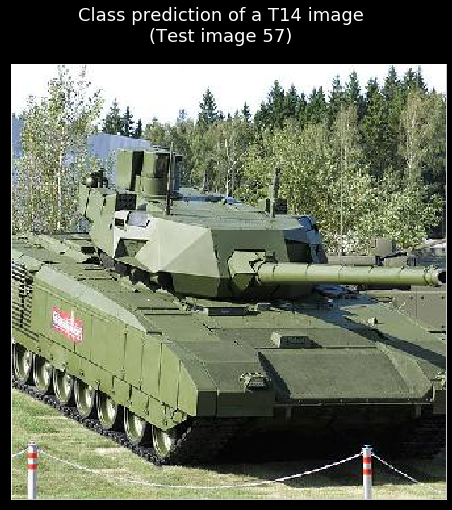

Image 58 : [(61.84, 'T14'), (17.71, 'T90'), (13.57, 'Background'), (3.33, 'Buk-M1-2'), (1.82, 'ZSU23'), (1.73, 'BMP2')]


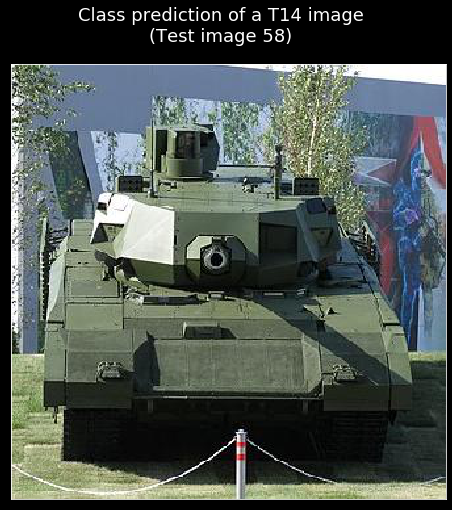

Image 59 : [(38.9, 'T14'), (33.44, 'T90'), (21.01, 'Buk-M1-2'), (2.55, 'BMP2'), (2.25, 'Background'), (1.85, 'ZSU23')]


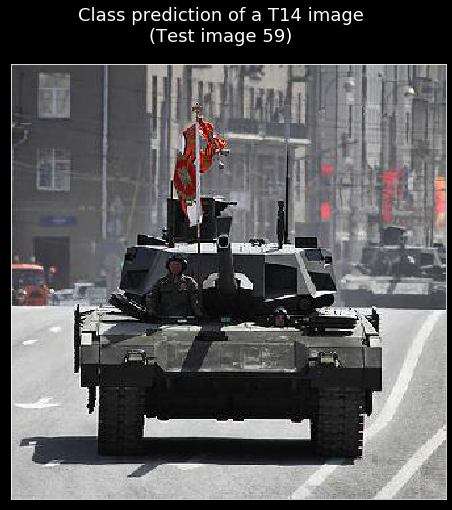

Image 60 : [(73.29, 'T14'), (11.8, 'T90'), (6.5, 'BMP2'), (5.24, 'Background'), (3.1, 'Buk-M1-2'), (0.08, 'ZSU23')]


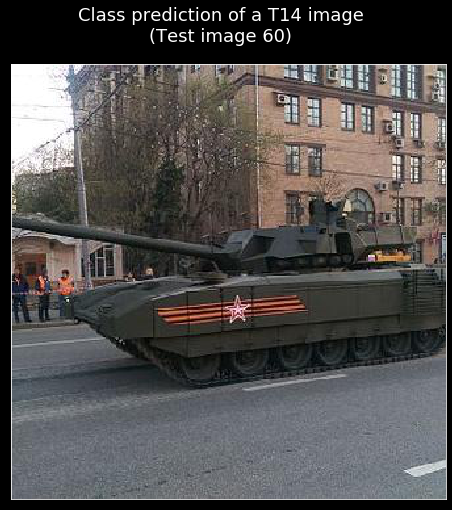

Image 61 : [(83.16, 'T90'), (7.85, 'T14'), (4.86, 'Background'), (1.68, 'Buk-M1-2'), (1.48, 'ZSU23'), (0.96, 'BMP2')]


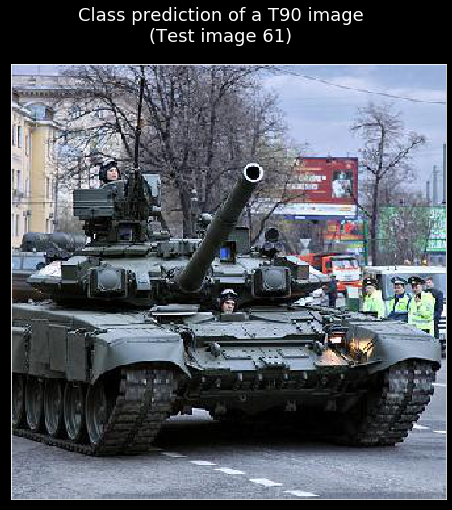

Image 62 : [(92.77, 'T90'), (3.47, 'Background'), (1.39, 'ZSU23'), (1.06, 'T14'), (0.66, 'Buk-M1-2'), (0.66, 'BMP2')]


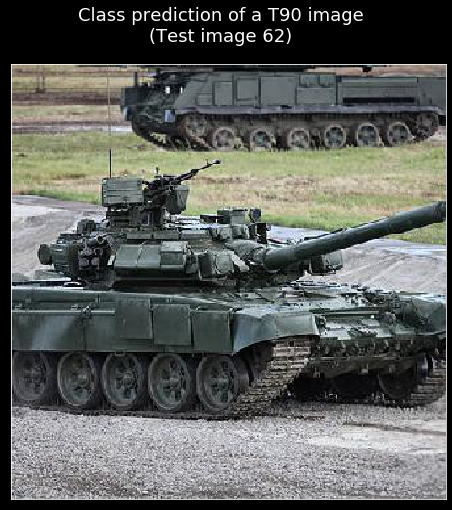

Image 63 : [(76.9, 'T90'), (8.56, 'BMP2'), (6.2, 'T14'), (5.33, 'Background'), (2.62, 'Buk-M1-2'), (0.39, 'ZSU23')]


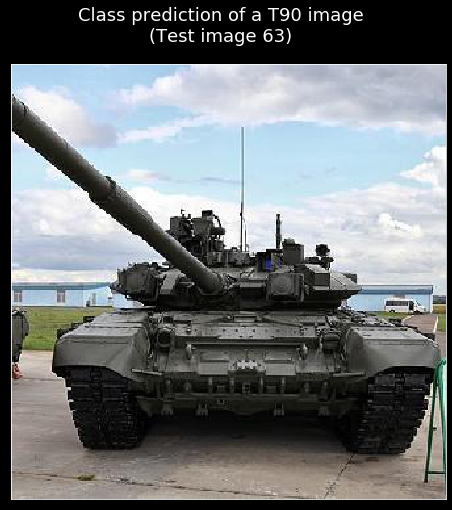

Image 64 : [(95.84, 'T90'), (2.29, 'Background'), (1.15, 'T14'), (0.32, 'ZSU23'), (0.28, 'Buk-M1-2'), (0.12, 'BMP2')]


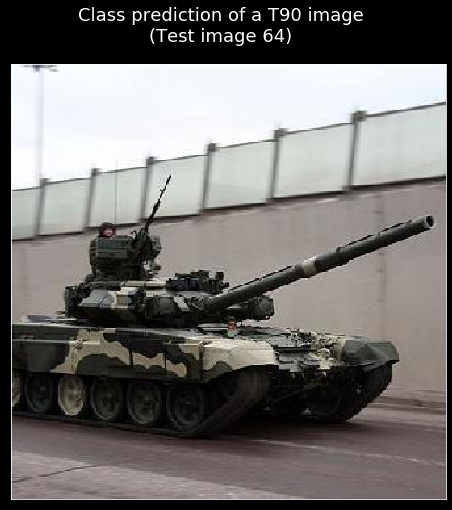

Image 65 : [(69.09, 'T90'), (22.26, 'ZSU23'), (5.52, 'Background'), (2.04, 'Buk-M1-2'), (0.89, 'T14'), (0.2, 'BMP2')]


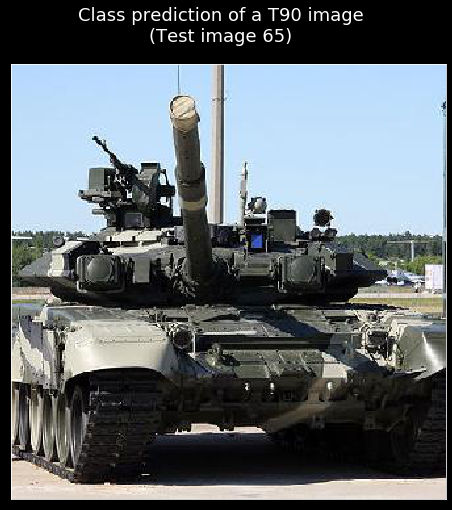

Image 66 : [(79.14, 'T90'), (12.3, 'T14'), (4.89, 'Background'), (1.83, 'ZSU23'), (1.27, 'Buk-M1-2'), (0.56, 'BMP2')]


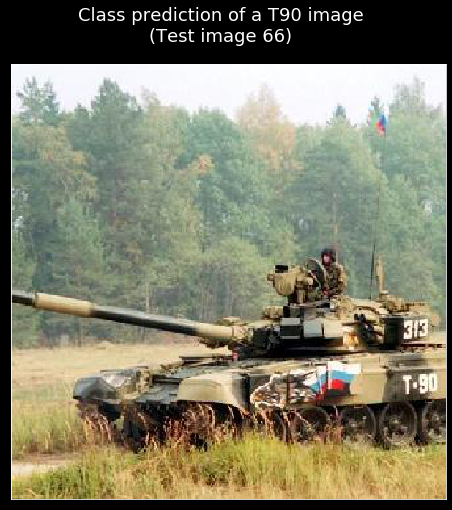

Image 67 : [(86.09, 'T90'), (6.88, 'Background'), (3.95, 'T14'), (1.89, 'Buk-M1-2'), (0.78, 'ZSU23'), (0.42, 'BMP2')]


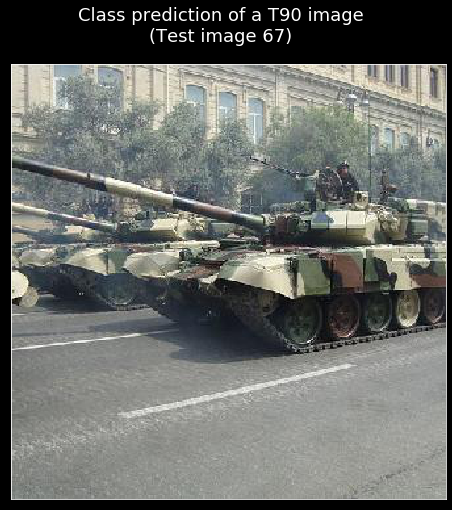

Image 68 : [(92.33, 'T90'), (3.66, 'Background'), (1.91, 'ZSU23'), (1.6, 'T14'), (0.39, 'Buk-M1-2'), (0.11, 'BMP2')]


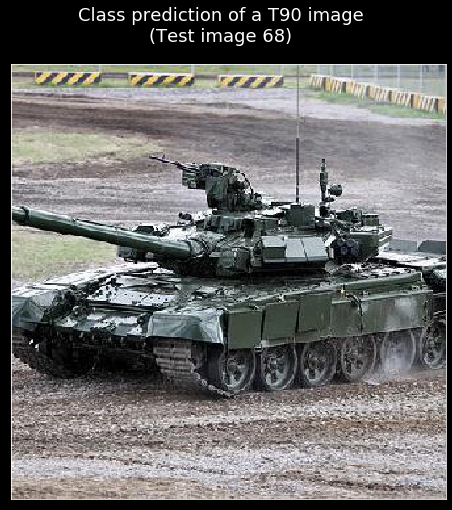

Image 69 : [(29.5, 'Buk-M1-2'), (22.6, 'T14'), (18.84, 'Background'), (15.54, 'T90'), (12.9, 'ZSU23'), (0.62, 'BMP2')]


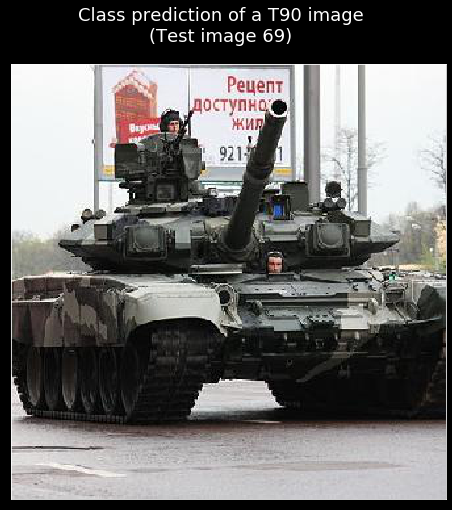

Image 70 : [(79.62, 'T90'), (12.38, 'Buk-M1-2'), (5.21, 'Background'), (1.5, 'BMP2'), (0.74, 'T14'), (0.54, 'ZSU23')]


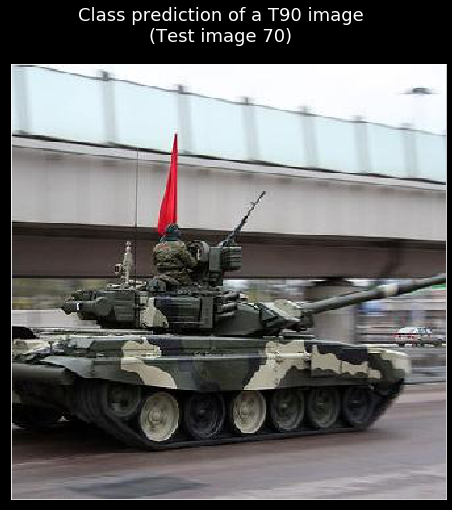

Image 71 : [(93.53, 'T90'), (2.87, 'Buk-M1-2'), (1.94, 'Background'), (0.77, 'T14'), (0.65, 'ZSU23'), (0.24, 'BMP2')]


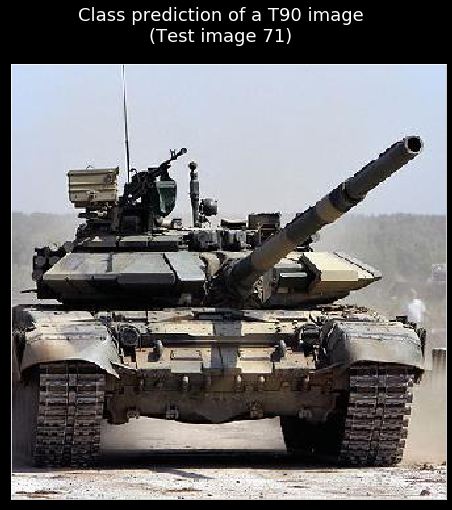

Image 72 : [(56.21, 'T90'), (18.98, 'Buk-M1-2'), (12.87, 'Background'), (9.38, 'BMP2'), (2.2, 'ZSU23'), (0.35, 'T14')]


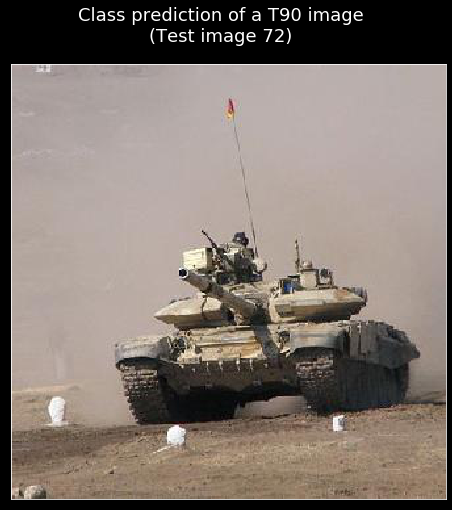

Image 73 : [(61.1, 'T90'), (23.05, 'T14'), (9.03, 'BMP2'), (3.93, 'Background'), (2.47, 'Buk-M1-2'), (0.43, 'ZSU23')]


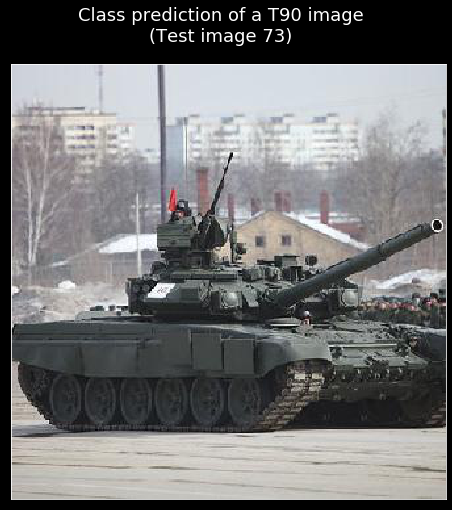

Image 74 : [(93.38, 'T90'), (3.32, 'Background'), (1.31, 'T14'), (1.13, 'ZSU23'), (0.51, 'Buk-M1-2'), (0.35, 'BMP2')]


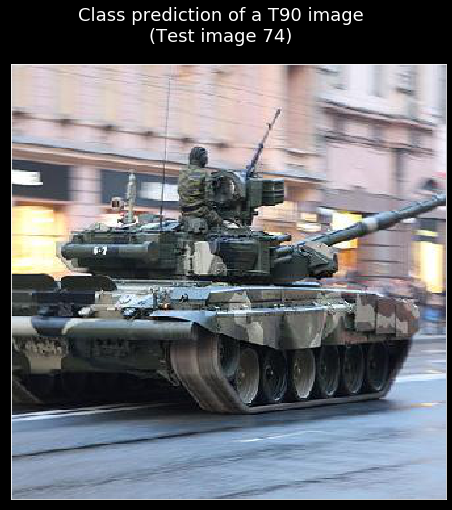

Image 75 : [(68.41, 'T90'), (21.21, 'T14'), (5.45, 'Background'), (2.78, 'Buk-M1-2'), (1.8, 'BMP2'), (0.35, 'ZSU23')]


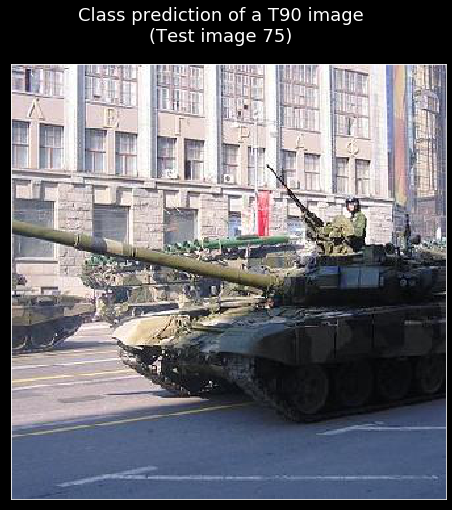

Image 76 : [(96.33, 'ZSU23'), (2.83, 'Buk-M1-2'), (0.64, 'Background'), (0.19, 'T90'), (0.01, 'T14'), (0.0, 'BMP2')]


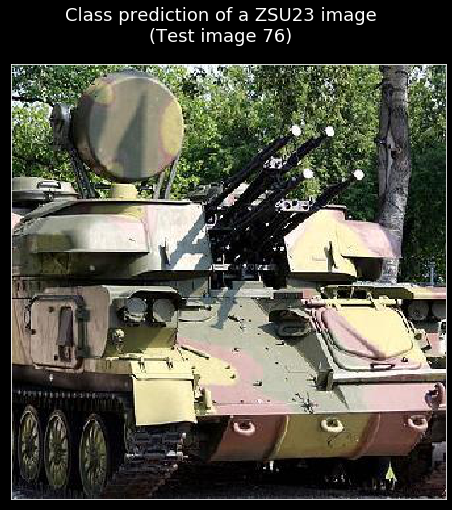

Image 77 : [(38.9, 'ZSU23'), (37.33, 'Buk-M1-2'), (14.76, 'T90'), (8.69, 'Background'), (0.16, 'T14'), (0.15, 'BMP2')]


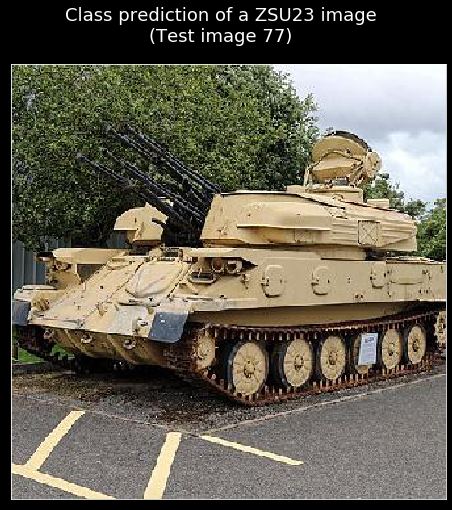

Image 78 : [(73.76, 'Buk-M1-2'), (12.84, 'T90'), (7.1, 'ZSU23'), (4.4, 'Background'), (1.52, 'BMP2'), (0.37, 'T14')]


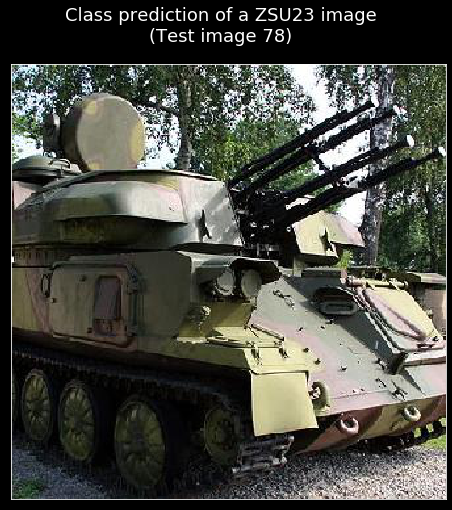

Image 79 : [(99.54, 'ZSU23'), (0.43, 'Buk-M1-2'), (0.02, 'Background'), (0.01, 'T90'), (0.0, 'T14'), (0.0, 'BMP2')]


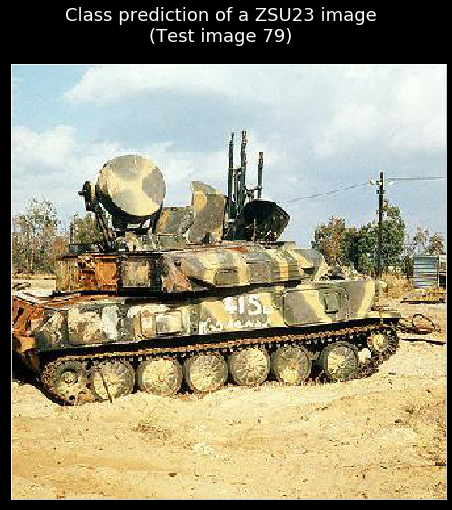

Image 80 : [(68.71, 'ZSU23'), (20.87, 'Buk-M1-2'), (6.32, 'Background'), (3.43, 'T90'), (0.6, 'BMP2'), (0.08, 'T14')]


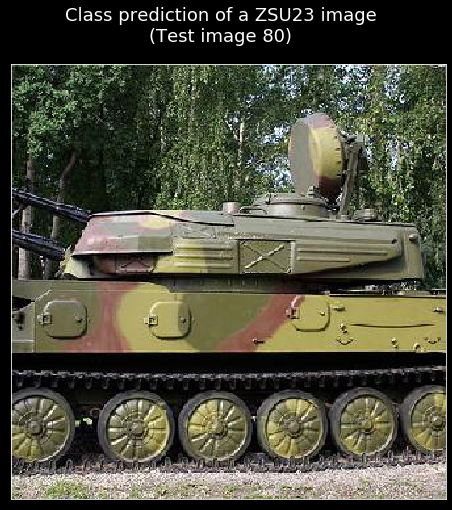

Image 81 : [(79.93, 'ZSU23'), (17.42, 'Buk-M1-2'), (2.34, 'Background'), (0.3, 'T90'), (0.01, 'T14'), (0.01, 'BMP2')]


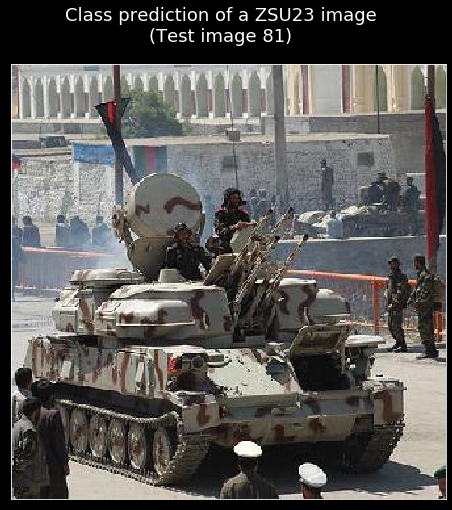

Image 82 : [(59.47, 'ZSU23'), (22.5, 'Background'), (11.14, 'Buk-M1-2'), (5.26, 'T90'), (1.5, 'BMP2'), (0.12, 'T14')]


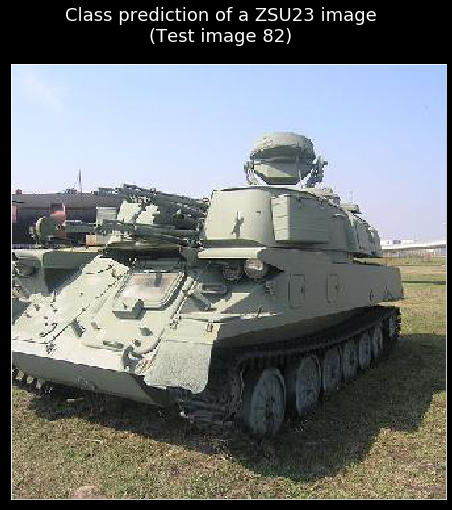

Image 83 : [(87.3, 'Buk-M1-2'), (6.65, 'T90'), (3.09, 'ZSU23'), (1.86, 'Background'), (0.95, 'T14'), (0.16, 'BMP2')]


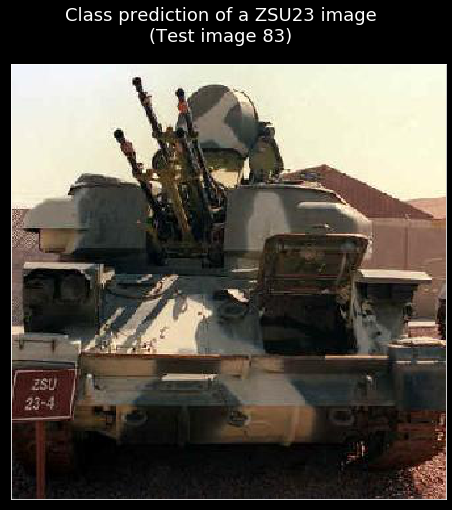

Image 84 : [(76.74, 'ZSU23'), (12.66, 'Buk-M1-2'), (8.19, 'Background'), (1.5, 'T90'), (0.46, 'T14'), (0.45, 'BMP2')]


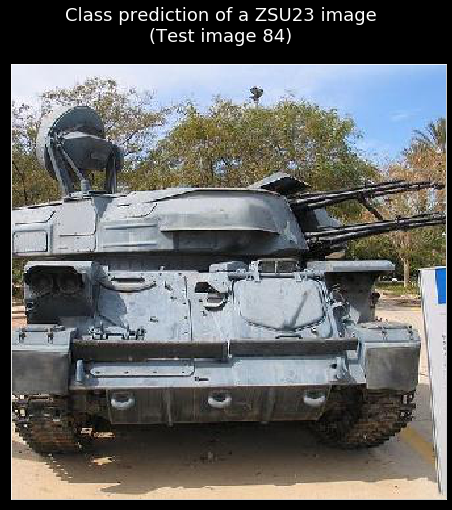

Image 85 : [(98.8, 'Buk-M1-2'), (0.59, 'T90'), (0.27, 'T14'), (0.14, 'BMP2'), (0.12, 'ZSU23'), (0.08, 'Background')]


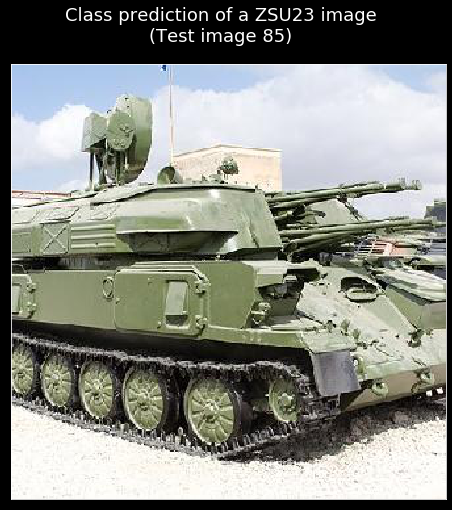

Image 86 : [(99.53, 'ZSU23'), (0.28, 'Background'), (0.14, 'T90'), (0.05, 'Buk-M1-2'), (0.01, 'BMP2'), (0.0, 'T14')]


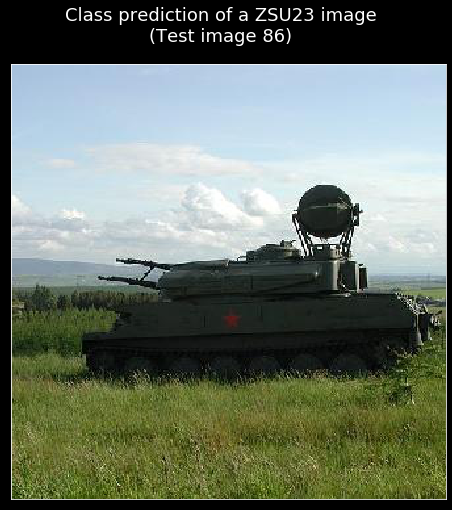

Image 87 : [(69.86, 'ZSU23'), (12.2, 'Background'), (10.4, 'Buk-M1-2'), (5.46, 'T90'), (2.03, 'BMP2'), (0.05, 'T14')]


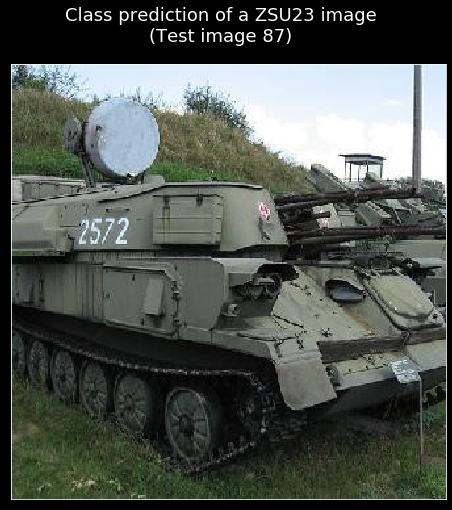

Image 88 : [(99.49, 'ZSU23'), (0.25, 'Background'), (0.2, 'Buk-M1-2'), (0.06, 'T90'), (0.01, 'BMP2'), (0.0, 'T14')]


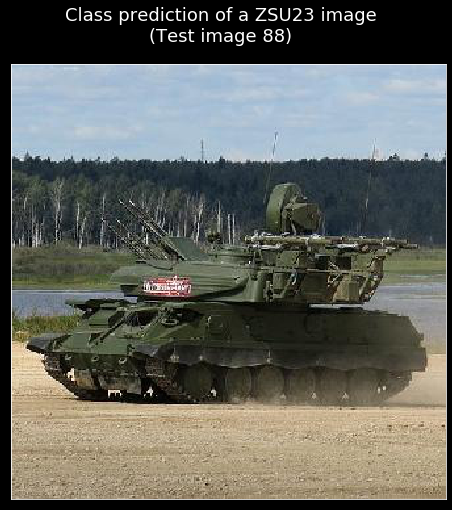

Image 89 : [(96.06, 'ZSU23'), (2.67, 'T90'), (0.86, 'Background'), (0.36, 'Buk-M1-2'), (0.03, 'BMP2'), (0.01, 'T14')]


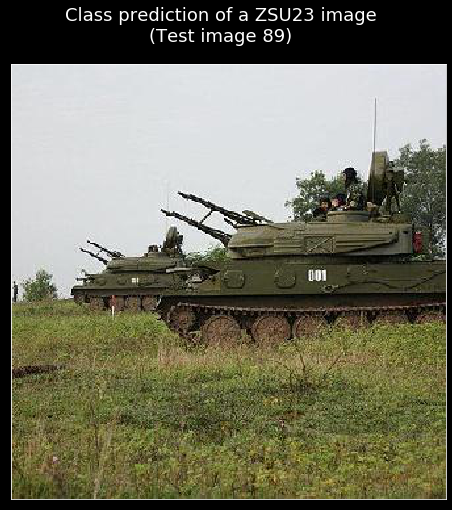

Image 90 : [(88.93, 'BMP2'), (4.19, 'Background'), (2.86, 'T90'), (1.94, 'T14'), (1.64, 'Buk-M1-2'), (0.46, 'ZSU23')]


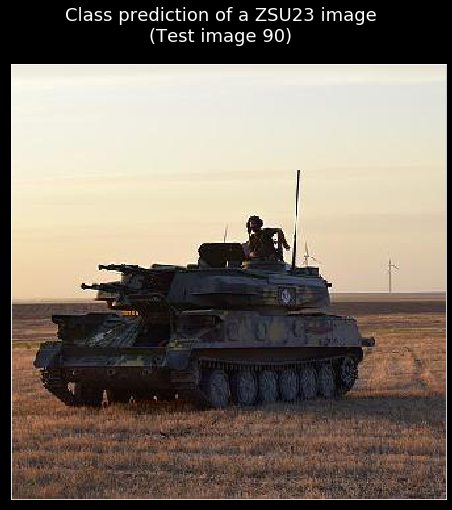

In [0]:
# Ugur Uysal

# ugur.uysal.86@gmail.com

# 02. Aug 2019



# imports

import os

import matplotlib.pyplot as plt

import numpy as np

from keras import models

from keras.preprocessing import image

from sklearn.metrics import classification_report, confusion_matrix

from sklearn.manifold import TSNE

import seaborn as sns





def main():

    analysis()

    plot_images()



# Setting Parameters ##################################################################

model_path = '/content/trained_models/RuTanks7000_v1_l2.h5'

test_path = '/content/RuTanks7000_v1/test/'  #  105 Test images



# image settings

img_height, img_width = 331, 331



classnames = ["Background", "BMP2", "Buk-M1-2", "T14", "T90", "ZSU23"]



# test data generator

test_datagen = image.ImageDataGenerator(rescale=1. / 255)

test_generator = test_datagen.flow_from_directory(

    test_path,

    target_size=(img_height, img_width),

    batch_size=1,

    shuffle=False,

    classes=classnames,

    class_mode='categorical')



# counting test images

nbrTestImages = 0  # Value gets accurate after counting

for ImagesClass in os.listdir(test_path):

    nbrTestImages += len(os.listdir(test_path + ImagesClass))



# saving test images from test generator

test_images = []

for i in range(nbrTestImages):

    test_images.append(test_generator.next()[0][0])



test_images_path = []

true_labels = []

true_labels_class = []



test_images_Background = os.listdir(test_path + 'Background')

for imagefile in test_images_Background:

    test_images_path.append(test_path + 'Background/' + imagefile)

    true_labels.append(0)

    true_labels_class.append('Background')



test_images_BMP2 = os.listdir(test_path + 'BMP2')

for imagefile in test_images_BMP2:

    test_images_path.append(test_path + 'BMP2/' + imagefile)

    true_labels.append(1)

    true_labels_class.append('BMP2')



test_images_Buk = os.listdir(test_path + 'Buk-M1-2')

for imagefile in test_images_Buk:

    test_images_path.append(test_path + 'Buk-M1-2/' + imagefile)

    true_labels.append(2)

    true_labels_class.append('Buk-M1-2')


test_images_T14 = os.listdir(test_path + 'T14')

for imagefile in test_images_T14:

    test_images_path.append(test_path + 'T14/' + imagefile)

    true_labels.append(3)

    true_labels_class.append('T14')



test_images_T90 = os.listdir(test_path + 'T90')

for imagefile in test_images_T90:

    test_images_path.append(test_path + 'T90/' + imagefile)

    true_labels.append(4)

    true_labels_class.append('T90')



test_images_ZSU23 = os.listdir(test_path + 'ZSU23')

for imagefile in test_images_ZSU23:

    test_images_path.append(test_path + 'ZSU23/' + imagefile)

    true_labels.append(5)

    true_labels_class.append('ZSU23')





# Returns the compiled model identical to the previously saved one

print("Loading the trained model from " + model_path + " ...\n")

model = models.load_model(model_path)

print("\nTrained model " + model_path + ":")

model.summary()



# predicting labels

pred = model.predict_generator(test_generator, nbrTestImages)

print("Dataset at", test_path, "has", pred.shape[0], "images with", pred.shape[1], "class predictions each")





def analysis():

    # testing the model

    print("\n### Testing the loaded model ... ")

    test_loss, test_acc = model.evaluate_generator(test_generator, steps=nbrTestImages, verbose=1)

    print('Test Results of the trained Model:\nTest loss:', test_loss, ",", 'test accuracy:', test_acc)



    # Confusion Matrix and Classification Report

    pred_argmax = np.argmax(pred, axis=1)

    print('\nConfusion Matrix')

    print(confusion_matrix(test_generator.classes, pred_argmax))

    print('\nClassification Report')

    print(classification_report(test_generator.classes, pred_argmax, target_names=classnames))



    # t-SNE Visualization: t-Distributed Stochastic Neighbor Embedding (t-SNE) for visualizing high-dimensional data.

    img_tensors = []

    for i in range(len(test_images)):

        pred_img = image.load_img(test_images_path[i], target_size=(331, 331))

        img_tensor = image.img_to_array(pred_img)

        img_tensor = np.expand_dims(img_tensor, axis=0)

        img_tensor /= 255.

        img_tensors.append(img_tensor)



    # Last conv layer

    layer = model.get_layer('dense_1')

    layer_output = layer.output

    activation_model = models.Model(input=model.input, outputs=[layer_output])



    img_tensors = np.asarray(img_tensors)

    img_tensors_array = np.concatenate((img_tensors))

    print("img_tensors_array.shape=", img_tensors_array.shape)



    activations = activation_model.predict(img_tensors_array)

    print("activations.shape=", activations.shape)



    # calculating tsne #https://www.datacamp.com/community/tutorials/introduction-t-sne

    tsne = TSNE(random_state=42).fit_transform(activations)



    # Visualization of the feature vectors produce by the convnet

    num_classes = len(classnames)

    palette = np.array(sns.color_palette("husl", num_classes))

    label_array = np.asarray(true_labels)



    # create a scatter plot.

    fig = plt.figure(figsize=(12, 12))

    fig.patch.set_facecolor('black')

    plt.style.use('dark_background')

    plt.scatter(tsne[:, 0], tsne[:, 1], lw=0, s=90, c=palette[label_array])

    plt.axis('tight')



    txts = []

    for j in range(num_classes):

        # Position of each label at median of data points.

        xtext, ytext = np.median(tsne[label_array == j, :], axis=0)

        txt = plt.text(xtext, ytext, classnames[j], fontsize=28, color = 'w')

        txts.append(txt)

    plt.show()





def plot_images():

    # plotting test images with class predictions as title

    print("\nClass Predictions of test images from", test_path)

    for k in range(len(test_images)):

        predictions = []

        for l in range(len(classnames)):

            predictions.append((np.round(pred[k][l] * 100, 2), classnames[l]))

        predictions.sort(reverse=True)

        print("Image", k + 1, ":", predictions)



        plt.figure(figsize=(8, 8))  # width, height in inches.

        plt.style.use('dark_background')

        plt.suptitle("Class prediction of a " + true_labels_class[k] + " image" + "\n(Test image " + str(k + 1) + ")", fontsize=18)

        plt.grid(False)

        plt.xticks([])

        plt.yticks([])

        

        plt.imshow(test_images[k])

        plt.show()

main()





# References

# Chollet, F. (2018). Deep learning with Python. Section 5.3 - Using a pretrained convnet.

# Pathak, M (2018). Introduction to t-SNE. Retrieved from https://www.datacamp.com/community/tutorials/introduction-t-sne